#Predicao Taxa Selic




In [1]:
pip install --upgrade xlrd

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
!pip install --upgrade pandas

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cached pandas-2.0.0-cp39-cp39-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (12.4 MB)
  Attempting uninstall: pandas
    Found existing installation: pandas 1.5.3
    Uninstalling pandas-1.5.3:
      Successfully uninstalled pandas-1.5.3
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
python-bcb 0.1.8 requires pandas<2.0.0,>=1.4.4, but you have pandas 2.0.0 which is incompatible.


In [3]:
!pip install python-bcb

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cached pandas-1.5.3-cp39-cp39-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (12.2 MB)
  Attempting uninstall: pandas
    Found existing installation: pandas 2.0.0
    Uninstalling pandas-2.0.0:
      Successfully uninstalled pandas-2.0.0


In [ ]:
!pip install pmdarima
##Solucao https://blog.csdn.net/qq_49821869/article/details/128540436
import os
os.kill(os.getpid(),9)


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


#Importacao das bibliotecas

In [1]:
!pip install sidrapy
import sidrapy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import date
from pmdarima import arima
import plotly.express as ploty
from datetime import datetime
from datetime import timedelta
import plotly.express as px
import plotly.graph_objs as go
import random

In [3]:
## testes de aderencia e estacionaridades
#https://www.statsmodels.org/dev/examples/notebooks/generated/stationarity_detrending_adf_kpss.html
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.stattools import kpss

In [4]:
pd.options.display.float_format = '{:.2f}'.format

In [5]:
%matplotlib inline
sns.set(rc={'figure.figsize':(20,10)})

#Importando os dados

In [6]:
data_inicio = '2000-01-01'

##Dados Banco Central

Taxa de juros - Selic acumulada no ano anualizada base 252 (% a.a.) - Freq. mensal

Núcleos de inflação - EX0, EX1, EX2, EX3, MS, MA, DP	Média - var. mensal (% m/m-1) - Freq. mensal	SGS/BCB

In [7]:
!pip install python-bcb

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


"IPCA-EX2" = 27838(Exclui os seguintes componentes de cada segmento do IPCA:

Administrados: todos os preços
Alimentação no domicílio: Cereais, leguminosas e oleaginosas; Farinhas, féculas e massas; Tubérculos, raízes e legumes; Açúcares e derivados; Hortaliças e verduras; Frutas; Carnes; Pescados; Aves e ovos; Leite e derivados; Óleos e gorduras; Sal e condimentos
Serviços: Passagem aérea; Hotel; Excursão; Mão-de-obra; Empregado doméstico; Cursos regulares; Cursos diversos; Telefone celular; Acesso à internet; Telefone com internet; TV por assinatura com internet
Bens industriais: Aparelhos eletroeletrônicos; Automóvel novo; Automóvel usado; Etanol; Fumo)

"IPCA-EX3" = 27839(Exclui os seguintes componentes de cada segmento do IPCA:

Administrados: todos os preços
Alimentação no domicílio: todos os preços
Serviços: Passagem aérea; Hotel; Excursão; Mão-de-obra; Empregado doméstico; Cursos regulares; Cursos diversos; Telefone celular; Acesso à internet; Telefone com internet; TV por assinatura com internet
Bens industriais: Aparelhos eletroeletrônicos; Automóvel novo; Automóvel usado; Etanol; Fumo)

"IPCA-MS"  = 4466(O núcleo de médias aparadas com suavização (MS) exclui 20% da variação de preços dos itens do IPCA de ambas as caudas da distribuição mensal, após a suavização de componentes com variações infrequentes e de grandes magnitudes.
O procedimento de cálculo mensal consiste em:
(i)                  suavizar os itens específicos*, calculando para eles a variação dos últimos 12 meses (ii) ordenar estes itens recalculados e os demais em ordem crescente de variação x1 < x2 < ... < xN;
(ii)                calcular a série acumulada de pesos a(i), i de 1 até N, de acordo com o novo ordenamento;
(iii)               calcular a série acumulada de pesos a(k), k de 1 até N, de acordo com o novo ordenamento;
(iv)               cortar itens que satisfaçam a(k) < 0,20 e itens a partir do segundo item que satisfaça a(k) > 0,80; e
(v)                reponderar os itens remanescentes e a partir de suas variações calcular o núcleo. Quando a(k) < 0,20 e a(k+1) > 0,20, o item k+1 entra no cálculo com peso equivalente à diferença entre seu peso acumulado e 0,20. Por exemplo, se o peso acumulado atingir 0,22 no item k+1, o seu peso na reponderação passa a ser 0,02. No outro limite, quando a(k) < 0,80 e a(k+1) > 0,80, o item k+1 entra no cálculo com peso equivalente à diferença entre 0,80 e o peso acumulado até k. Por exemplo, se o peso acumulado atingir 0,77 no item k, o peso do item k+1 na reponderação passa a ser 0,03.
*Itens suavizados: Combustíveis domésticos, Energia elétrica residencial, Transporte público, Combustíveis (veículos), Serviços pessoais, Fumo, Cursos regulares, Cursos diversos e Comunicação.)

"IPCA-MA"  = 11426(O núcleo por médias aparadas (MA) exclui os itens cuja variação mensal se situe, na distribuição, acima do percentil 80 ou abaixo do percentil 20. Os 60% restantes são utilizados para calcular a variação mensal do núcleo.
O procedimento de cálculo mensal consiste em:
(i)                  ordenar os itens em ordem crescente de variação: x1 < x2 < ... < xN;
(ii)                calcular a série acumulada de pesos a(k), k de 1 até N, de acordo com o novo ordenamento;
(iii)               cortar itens que satisfaçam a(k) < 0,20 e itens a partir do segundo item que satisfaça a(k) > 0,80; e
(iv)               reponderar os itens remanescentes e a partir de suas variações calcular o núcleo. Quando a(k) < 0,20 e a(k+1) > 0,20, o item k+1 entra no cálculo com peso equivalente à diferença entre seu peso acumulado e 0,20. Por exemplo, se o peso acumulado atingir 0,22 no item k+1, o seu peso na reponderação passa a ser 0,02. No outro limite, quando a(k) < 0,80 e a(k+1) > 0,80, o item k+1 entra no cálculo com peso equivalente à diferença entre 0,80 e o peso acumulado até k. Por exemplo, se o peso acumulado atingir 0,77 no item k, o peso do item k+1 na reponderação passa a ser 0,03.)

"IPCA-EX0" = 11427(São excluídos do IPCA os preços do subgrupo alimentação no domicílio e do segmento de administrados.)

"IPCA-EX1" = 16121(São excluídos do IPCA 10 dos 16 itens do subgrupo Alimentação no Domicílio (Tubérculos, raízes e legumes; Cereais, leguminosas e oleaginosas; Hortaliças e verduras; Frutas; Carnes; Pescados; Açúcares e derivados; Leites e derivados; Aves e ovos; e Óleos e gorduras), além dos itens combustíveis domésticos e combustíveis de veículos.)

"IPCA-DP"  = 16122( O núcleo de dupla ponderação (DP) ajusta os pesos originais de cada item de acordo com sua volatilidade relativa, reduzindo a importância de componentes mais voláteis.

O procedimento de cálculo mensal consiste em: (i) calcular para cada item o desvio padrão da série de diferenças entre a sua variação e a do IPCA nos últimos 48 meses sigma(k); (ii) calcular novos p(k)* = [p(k)/sigma(k)]/[Sum(i) p(i)/sigma(i)]; (iii) utilizar os pesos p* para ponderar as variações de preço dos diferentes itens do IPCA.)

In [8]:
from bcb import sgs
dados_banco_central = sgs.get({'selic':4189,'IPCA-EX2':27838,'IPCA-EX3':27839,
                               'IPCA-MS':4466,'IPCA-MA':11426,'IPCA-EX0':11427,
                               'IPCA-EX1':16121,'IPCA-DP':16122},start = data_inicio)
dados_banco_central

,selic,IPCA-EX2,IPCA-EX3,IPCA-MS,IPCA-MA,IPCA-EX0,IPCA-EX1,IPCA-DP
Date,,,,,,,,
2000-01-01,18.94,0.42,0.33,0.48,NaN,0.56,0.63,0.47
2000-02-01,18.87,0.17,0.21,0.44,NaN,0.45,0.32,0.32
2000-03-01,18.85,-0.11,-0.03,0.37,NaN,0.05,0.16,0.21
2000-04-01,18.62,0.16,0.22,0.45,NaN,0.87,0.62,0.60
2000-05-01,18.51,0.12,0.16,0.35,NaN,0.20,0.19,0.18
...,...,...,...,...,...,...,...,...
2022-12-01,13.65,0.99,1.02,0.49,0.49,0.74,0.74,0.61
2023-01-01,13.65,0.36,0.33,0.49,0.56,0.43,0.53,0.66
2023-02-01,13.65,0.62,0.64,0.48,0.62,1.06,1.00,0.76


##Dados de IBGE

In [9]:
!pip install sidrapy
import sidrapy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [10]:
import pandas as pd

def trimestral_para_mensal(df):
  """
   A função recebe um DataFrame df com valores trimestrais do PIB. Primeiro, ela aplica a interpolação para obter os valores mensais, usando o método resample com uma frequência de 'M' e o método interpolate para preencher os valores faltantes. 
   Em seguida, ela percorre os valores de cada trimestre e distribui a variação trimestral em cada um dos três meses dentro do trimestre, adicionando um terço do valor trimestral aos dois meses intermediários. Finalmente, ela retorna o DataFrame 
   interpolado e transformado em mensal.
   """
  
  # Primeiro, definimos uma nova frequência mensal e aplicamos a interpolação
  df_mensal = df.resample('MS').interpolate()
    
  # Em seguida, distribuímos a variação trimestral em cada um dos três meses dentro do trimestre
  for i in range(1, len(df)):
    if i % 3 != 0:
        val = df.iloc[i].values[0]
        month_val = val / 3
        df_mensal.iloc[i*2-1] += month_val
        df_mensal.iloc[i*2] += month_val
    
  return df_mensal

In [11]:
def transforme_data(data):
  from datetime import datetime

  months = {'janeiro': 'january', 'fevereiro': 'february', 'março': 'march',
          'abril': 'april', 'maio': 'may', 'junho': 'june',
          'julho': 'july', 'agosto': 'august', 'setembro': 'september',
          'outubro': 'october', 'novembro': 'november', 'dezembro': 'december'}

  lista_data = []
  for date in data.index:
      date_components = date.split(' ')
      formatted_month = months[date_components[0].lower()].capitalize()
      formatted_date = f"{formatted_month} {date_components[1]}"
      date_object = datetime.strptime(formatted_date, '%B %Y')
      lista_data.append(date_object.strftime('%Y-%m-%d'))
  data.index = lista_data
  return data


In [12]:
from datetime import datetime

def converter_mes_para_data(mes):
    mes_texto = str(mes)
    ano = int(mes_texto[:4])
    mes = int(mes_texto[4:])
    data = datetime(year=ano, month=mes, day=1)
    return data

### IPCA

/t/1737/n1/all/v/63/p/all/d/v63%202

In [13]:
ipca = sidrapy.get_table(table_code = '1737',
                             territorial_level = '1',
                             ibge_territorial_code = 'all',
                             variable = '63',
                             period = 'all')
ipca.columns = ipca.iloc[0,:]
ipca = ipca.iloc[1:,:]
ipca['data'] = ipca['Mês (Código)'].apply(converter_mes_para_data)
ipca.index = ipca['data']
ipca['Valor'] = ipca['Valor'][1:].astype(float)
ipca.head()

,Nível Territorial (Código),Nível Territorial,Unidade de Medida (Código),Unidade de Medida,Valor,Brasil (Código),Brasil,Mês (Código),Mês,Variável (Código),Variável,data
data,,,,,,,,,,,,
1979-12-01,1,Brasil,,,NaN,1,Brasil,197912,dezembro 1979,63,IPCA - Variação mensal,1979-12-01
1980-01-01,1,Brasil,2,%,6.62,1,Brasil,198001,janeiro 1980,63,IPCA - Variação mensal,1980-01-01
1980-02-01,1,Brasil,2,%,4.62,1,Brasil,198002,fevereiro 1980,63,IPCA - Variação mensal,1980-02-01
1980-03-01,1,Brasil,2,%,6.04,1,Brasil,198003,março 1980,63,IPCA - Variação mensal,1980-03-01
1980-04-01,1,Brasil,2,%,5.29,1,Brasil,198004,abril 1980,63,IPCA - Variação mensal,1980-04-01


###PIB_TRIMESTRAL
/t/5932/n1/all/v/6564/p/all/c11255/90707/d/v6564%201
preços de mercado	Var. trim. (% t/t-1) - Freq. trimestral

In [14]:
def trimestre_string_int(dados):
  lista_trimestre = []
  for i in range(len(dados.index)):
    lista_trimestre.append(dados.index[i][-4:]+'-'+'0'+dados.index[i][0])
  return lista_trimestre

In [15]:
def transforma_para_mes_incial_trimestre(dados):
  lista_mes = []
  for i in range(len(dados.index)):
    trimestre = dados.index.month[i]
    ano = str(dados.index.year[i])
    lista_mes.append(str(np.where(trimestre == 1,ano+'-'+'0'+str(trimestre),
        np.where(trimestre == 2,ano+'-'+'0'+str(trimestre+2),
        np.where(trimestre==3,ano+'-'+'0'+str(trimestre+4),
        np.where(trimestre==4,ano+'-'+str(trimestre+6),0))))))
  return lista_mes

In [16]:
import pandas as pd

url = 'https://sidra.ibge.gov.br/geratabela?format=xlsx&name=tabela5932.xlsx&terr=N&rank=-&query=t/5932/n1/all/v/6561/p/all/c11255/90707/d/v6561%201/l/v,p%2Bc11255,t'

# carregar a tabela em um DataFrame
pib = pd.read_excel(url, header=3)

# exibir as primeiras linhas do DataFrame
pib = pib.T
pib = pib.iloc[1:]
pib = pib[[1]]
pib.columns = ['pib']
pib = pib.astype(float)
pib.index = pd.to_datetime(trimestre_string_int(pib))
pib.index = pd.to_datetime(transforma_para_mes_incial_trimestre(pib))
pib_mensal = pib.resample('MS').fillna(method='ffill')
pib_mensal

,pib
1996-01-01,-0.60
1996-02-01,-0.60
1996-03-01,-0.60
1996-04-01,1.30
1996-05-01,1.30
...,...
2022-06-01,3.70
2022-07-01,3.60
2022-08-01,3.60
2022-09-01,3.60




###Despesa de consumo da administracao publica(TRIMESTRAL)

In [17]:
import pandas as pd

url = 'https://sidra.ibge.gov.br/geratabela?format=xlsx&name=tabela5932.xlsx&terr=N&rank=-&query=t/5932/n1/all/v/6561/p/all/c11255/93405/d/v6561%201/l/v,p%2Bc11255,t'

# carregar a tabela em um DataFrame
consumo_publica = pd.read_excel(url, header=3)

# exibir as primeiras linhas do DataFrame
consumo_publica = consumo_publica.T
consumo_publica = consumo_publica.iloc[1:]
consumo_publica = consumo_publica[[1]]
consumo_publica.columns = ['consumo_publica']
consumo_publica = consumo_publica.astype(float)
consumo_publica.index =pd.to_datetime(trimestre_string_int(consumo_publica))
consumo_publica.index = pd.to_datetime(transforma_para_mes_incial_trimestre(consumo_publica))
consumo_publica_mensal = consumo_publica.resample('MS').fillna(method='ffill')
consumo_publica_mensal

,consumo_publica
1996-01-01,-3.30
1996-02-01,-3.30
1996-03-01,-3.30
1996-04-01,-0.20
1996-05-01,-0.20
...,...
2022-06-01,0.90
2022-07-01,1.00
2022-08-01,1.00
2022-09-01,1.00


###Formacao bruta de capital fixo (TRIMESTRAL)

In [18]:
url = 'https://sidra.ibge.gov.br/geratabela?format=xlsx&name=tabela5932.xlsx&terr=N&rank=-&query=t/5932/n1/all/v/6561/p/all/c11255/93406/d/v6561%201/l/v,p%2Bc11255,t'

# carregar a tabela em um DataFrame
formacao_bruta = pd.read_excel(url, header=3)

# exibir as primeiras linhas do DataFrame
formacao_bruta = formacao_bruta.T
formacao_bruta = formacao_bruta.iloc[1:]
formacao_bruta = formacao_bruta[[1]]
formacao_bruta.columns = ['formacao_bruta']
formacao_bruta = formacao_bruta.astype(float)
formacao_bruta.index =pd.to_datetime(trimestre_string_int(formacao_bruta))
formacao_bruta.index = pd.to_datetime(transforma_para_mes_incial_trimestre(formacao_bruta))
formacao_bruta_mensal = formacao_bruta.resample('MS').fillna(method='ffill')
formacao_bruta_mensal

,formacao_bruta
1996-01-01,-12.70
1996-02-01,-12.70
1996-03-01,-12.70
1996-04-01,-4.10
1996-05-01,-4.10
...,...
2022-06-01,1.50
2022-07-01,5.00
2022-08-01,5.00
2022-09-01,5.00


In [19]:
formacao_bruta

,formacao_bruta
1996-01-01,-12.70
1996-04-01,-4.10
1996-07-01,10.10
1996-10-01,13.90
1997-01-01,11.30
...,...
2021-10-01,3.20
2022-01-01,-6.40
2022-04-01,1.50
2022-07-01,5.00


###Produção indústrias de manufatureiras
t/8158/n1/all/v/11599/p/all/c543/129278/d/v11599%205

In [20]:
import pandas as pd

url = 'https://sidra.ibge.gov.br/geratabela?format=xlsx&name=tabela8158.xlsx&terr=N&rank=-&query=t/8158/n1/all/v/11599/p/all/c543/129278/d/v11599%205/l/v,p%2Bc543,t'

# carregar a tabela em um DataFrame
producao_industrial_manufatureira = pd.read_excel(url, header=3)

# exibir as primeiras linhas do DataFrame
producao_industrial_manufatureira = producao_industrial_manufatureira.T
producao_industrial_manufatureira = producao_industrial_manufatureira.iloc[1:]
producao_industrial_manufatureira = producao_industrial_manufatureira[[1]]
producao_industrial_manufatureira.columns = ['producao_industrial_manufatureira']
producao_industrial_manufatureira = transforme_data(producao_industrial_manufatureira)
producao_industrial_manufatureira = producao_industrial_manufatureira.astype(float)
producao_industrial_manufatureira.index = pd.to_datetime(producao_industrial_manufatureira.index)
producao_industrial_manufatureira.head()

,producao_industrial_manufatureira
2002-01-01,51.67
2002-02-01,50.39
2002-03-01,57.44
2002-04-01,61.18
2002-05-01,59.20


##Metas de inflacao

In [21]:
import pandas as pd
import numpy as np
import requests
from bs4 import BeautifulSoup
import re
from datetime import datetime
import calendar
import math

# Load the web page and extract the table contents
url = 'https://www.bcb.gov.br/api/paginasite/sitebcb/controleinflacao/historicometas'
page = requests.get(url)
soup = BeautifulSoup(page.content, 'html.parser')
table = soup.find_all('table')[0]

# Extract the data and inflation target columns and remove unwanted rows
td = table.find_all('td')
# Define regular expressions to extract the year and inflation target values
year_regex = r'<td>(\d{4})<br/></td>'
year_tags = re.findall(year_regex, str(td))

##Pergar meta de inflacao
meta_inflacao = []
ano_inflacao = []
tamanhao_intervalo = []
inflacao_efetiva = []
index = 0
for i in range(3):
  meta_inflacao.append(td[8+index].get_text())
  ano_inflacao.append(td[7+index].get_text())
  inflacao_efetiva.append(td[11+index].get_text())
  index = index+5
index = 0
for i in range(math.ceil((len(td)-20)/7)):
  meta_inflacao.append(td[20+index].get_text())
  ano_inflacao.append(td[17+index].get_text())
  inflacao_efetiva.append(td[23+index].get_text())
  index = index+7
historico_inflacao = pd.DataFrame()
historico_inflacao['meta_inflacao'] = meta_inflacao
historico_inflacao['anos'] = ano_inflacao
historico_inflacao['inflacao_efetiva'] = inflacao_efetiva

#Apagando a linha 2
historico_inflacao.drop(2,axis=0,inplace=True)
historico_inflacao.loc[4,'inflacao_efetiva'] = historico_inflacao.loc[4,'inflacao_efetiva'][:3]
historico_inflacao.loc[5,'meta_inflacao'] = historico_inflacao.loc[5,'meta_inflacao'][:3]
historico_inflacao.loc[0,'meta_inflacao'] = historico_inflacao.loc[0,'meta_inflacao'][-1]
historico_inflacao.loc[21,'meta_inflacao'] = historico_inflacao.loc[21,'meta_inflacao'][-1]

#Funcao para tirar valores \u200b
funcao = [lambda x: x.replace('\u200b', '')]
funcao_2 = [lambda x: x.replace(',', '.')]
funcao_3 = [lambda x: x.replace('*', '')]
#Arruma a coluna meta inflacao
historico_inflacao['meta_inflacao'] = historico_inflacao['meta_inflacao'].apply(funcao).apply(funcao_2).astype(float)
#Arruma coluna anos
historico_inflacao['anos'] = historico_inflacao['anos'].apply(funcao_3)
#Coverte em flutuante a coluna inflacao_efetiva
historico_inflacao['inflacao_efetiva'] = historico_inflacao['inflacao_efetiva'].apply(funcao).apply(funcao_2)
historico_inflacao['inflacao_efetiva']=pd.to_numeric(historico_inflacao['inflacao_efetiva'], errors='coerce').tolist()
historico_inflacao['diferenca_meta_efetiva'] = historico_inflacao['meta_inflacao'] - historico_inflacao['inflacao_efetiva']

In [22]:
##Interpolando valores para os meses
historico_inflacao_mensal = historico_inflacao.copy()
historico_inflacao_mensal.set_index('anos', inplace=True)
historico_inflacao_mensal.index = pd.to_datetime(historico_inflacao_mensal.index.str.strip(), format='%Y')
historico_inflacao_mensal = historico_inflacao_mensal.resample('MS').interpolate(method='pad')

In [23]:
historico_inflacao_mensal

,meta_inflacao,inflacao_efetiva,diferenca_meta_efetiva
anos,,,
2000-01-01,6.00,5.97,0.03
2000-02-01,6.00,5.97,0.03
2000-03-01,6.00,5.97,0.03
2000-04-01,6.00,5.97,0.03
2000-05-01,6.00,5.97,0.03
...,...,...,...
2024-09-01,3.00,5.79,-2.29
2024-10-01,3.00,5.79,-2.29
2024-11-01,3.00,5.79,-2.29


##Focus

###Expectativas IPCA

In [24]:
!pip install python-bcb

from bcb import Expectativas

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [25]:
# End point
em = Expectativas()
ep = em.get_endpoint('ExpectativaMercadoMensais')

# Dados do IPCA

ipca_expec = (ep.query()
 .filter(ep.Indicador == 'IPCA')
 .filter(ep.Data >= data_inicio)
 .filter(ep.baseCalculo == 0)
 .select(ep.Indicador, ep.Data, ep.Media, ep.Mediana, ep.DataReferencia,ep.baseCalculo)
 .collect()
  )

dados_ipca = ipca_expec.copy()
dados_ipca = dados_ipca[::-1]
dados_ipca['monthyear'] = pd.to_datetime(dados_ipca['Data']).apply(lambda x: x.strftime("%Y-%m"))
dados_ipca = dados_ipca.groupby('monthyear').mean()
# criar índice com o formato "YYYY-MM"
dados_ipca.index = pd.to_datetime(dados_ipca.index, format='%Y-%m')

# adicionar o dia como "01"
dados_ipca.index = dados_ipca.index.to_period('M').to_timestamp()

dados_ipca

<ipython-input-25-b61fe3d07283>:18: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  dados_ipca = dados_ipca.groupby('monthyear').mean()


,Media,Mediana,baseCalculo
monthyear,,,
2000-01-01,0.55,0.52,0.00
2000-02-01,0.55,0.53,0.00
2000-03-01,0.59,0.59,0.00
2000-04-01,0.58,0.59,0.00
2000-05-01,0.58,0.56,0.00
...,...,...,...
2022-12-01,0.37,0.37,0.00
2023-01-01,0.38,0.37,0.00
2023-02-01,0.40,0.39,0.00


##Juntando os dados

In [26]:
data_index = pd.date_range(start=data_inicio,end=datetime.today().strftime('%Y-%m-%d'),freq='MS')

In [27]:
dados = pd.DataFrame(index=data_index)

In [28]:
dados['selic'] = dados_banco_central['selic']
dados['IPCA-EX2'] = dados_banco_central['IPCA-EX2']
dados['IPCA-EX3'] = dados_banco_central['IPCA-EX3']
dados['IPCA-MS'] = dados_banco_central['IPCA-MS']
dados['IPCA-MA'] = dados_banco_central['IPCA-MA']
dados['IPCA-EX0'] = dados_banco_central['IPCA-EX0']
dados['IPCA-EX1'] = dados_banco_central['IPCA-EX1']
dados['IPCA-EX1'] = dados_banco_central['IPCA-EX1']
dados['ipca'] = ipca['Valor']
dados['pib_mensal'] = pib_mensal['pib']
dados['consumo_publica_mensal'] = consumo_publica_mensal['consumo_publica']
dados['formacao_bruta_mensal'] = formacao_bruta_mensal['formacao_bruta']
dados['producao_industrial_manufatureira'] = producao_industrial_manufatureira['producao_industrial_manufatureira']
dados['meta_inflacao'] = historico_inflacao_mensal['meta_inflacao']
dados['diferenca_meta_efetiva'] = historico_inflacao_mensal['diferenca_meta_efetiva']
dados['expectativa_inflacao'] = dados_ipca['Mediana']
dados

,selic,IPCA-EX2,IPCA-EX3,IPCA-MS,IPCA-MA,IPCA-EX0,IPCA-EX1,ipca,pib_mensal,consumo_publica_mensal,formacao_bruta_mensal,producao_industrial_manufatureira,meta_inflacao,diferenca_meta_efetiva,expectativa_inflacao
2000-01-01,18.94,0.42,0.33,0.48,NaN,0.56,0.63,0.62,4.40,3.60,-0.30,NaN,6.00,0.03,0.52
2000-02-01,18.87,0.17,0.21,0.44,NaN,0.45,0.32,0.13,4.40,3.60,-0.30,NaN,6.00,0.03,0.53
2000-03-01,18.85,-0.11,-0.03,0.37,NaN,0.05,0.16,0.22,4.40,3.60,-0.30,NaN,6.00,0.03,0.59
2000-04-01,18.62,0.16,0.22,0.45,NaN,0.87,0.62,0.42,4.00,1.30,3.90,NaN,6.00,0.03,0.59
2000-05-01,18.51,0.12,0.16,0.35,NaN,0.20,0.19,0.01,4.00,1.30,3.90,NaN,6.00,0.03,0.56
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-01,13.65,0.99,1.02,0.49,0.49,0.74,0.74,0.62,NaN,NaN,NaN,84.26,3.50,-2.29,0.37
2023-01-01,13.65,0.36,0.33,0.49,0.56,0.43,0.53,0.53,NaN,NaN,NaN,NaN,3.25,-2.29,0.37
2023-02-01,13.65,0.62,0.64,0.48,0.62,1.06,1.00,0.84,NaN,NaN,NaN,NaN,3.25,-2.29,0.39
2023-03-01,13.65,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.25,-2.29,0.39


#Criando modelo mensal 

##Tratando os dados

In [29]:
dados.isnull().sum()

selic                                 0
IPCA-EX2                              2
IPCA-EX3                              2
IPCA-MS                               2
IPCA-MA                              14
IPCA-EX0                              2
IPCA-EX1                              2
ipca                                  2
pib_mensal                            6
consumo_publica_mensal                6
formacao_bruta_mensal                 6
producao_industrial_manufatureira    28
meta_inflacao                         0
diferenca_meta_efetiva                0
expectativa_inflacao                  0
dtype: int64

In [30]:
def plotar(dados):
  for i in range(len(dados.columns)):
    fig, ax = plt.subplots(dpi=120)
    ax.plot(dados.iloc[:,i],label=dados.columns[i])
    plt.legend()
    plt.show()

In [31]:
plotar(dados)

Output hidden; open in https://colab.research.google.com to view.

###Criando dummy Covid para as 2020-04-01 e 2020-05-01

In [32]:
dados['dummy_covid'] = np.where((dados.index >= pd.to_datetime('2020-04-01')) & (dados.index <= pd.to_datetime('2020-05-01')), 1,0)
dados

,selic,IPCA-EX2,IPCA-EX3,IPCA-MS,IPCA-MA,IPCA-EX0,IPCA-EX1,ipca,pib_mensal,consumo_publica_mensal,formacao_bruta_mensal,producao_industrial_manufatureira,meta_inflacao,diferenca_meta_efetiva,expectativa_inflacao,dummy_covid
2000-01-01,18.94,0.42,0.33,0.48,NaN,0.56,0.63,0.62,4.40,3.60,-0.30,NaN,6.00,0.03,0.52,0
2000-02-01,18.87,0.17,0.21,0.44,NaN,0.45,0.32,0.13,4.40,3.60,-0.30,NaN,6.00,0.03,0.53,0
2000-03-01,18.85,-0.11,-0.03,0.37,NaN,0.05,0.16,0.22,4.40,3.60,-0.30,NaN,6.00,0.03,0.59,0
2000-04-01,18.62,0.16,0.22,0.45,NaN,0.87,0.62,0.42,4.00,1.30,3.90,NaN,6.00,0.03,0.59,0
2000-05-01,18.51,0.12,0.16,0.35,NaN,0.20,0.19,0.01,4.00,1.30,3.90,NaN,6.00,0.03,0.56,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-01,13.65,0.99,1.02,0.49,0.49,0.74,0.74,0.62,NaN,NaN,NaN,84.26,3.50,-2.29,0.37,0
2023-01-01,13.65,0.36,0.33,0.49,0.56,0.43,0.53,0.53,NaN,NaN,NaN,NaN,3.25,-2.29,0.37,0
2023-02-01,13.65,0.62,0.64,0.48,0.62,1.06,1.00,0.84,NaN,NaN,NaN,NaN,3.25,-2.29,0.39,0
2023-03-01,13.65,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.25,-2.29,0.39,0


###Fazendo Backcasting nos valores faltantes com arvores de decisao

In [33]:
dados_interpolacao = dados.copy()

In [34]:
from sklearn.tree import DecisionTreeRegressor
from xgboost import XGBRegressor

In [35]:
colunas=dados.columns.tolist()

In [36]:
np.random.seed(0)
dados_bac = dados.copy()
for i in colunas:
    dados_interpolacao = dados.copy()

    dados_interpolacao = dados_interpolacao.loc[:dados_interpolacao[i].last_valid_index()]


    # Separate values not NaN and NaN in two different dataframes
    treino_interpolacao = dados_interpolacao[dados_interpolacao[i].notnull()]
    predicao_interpolacao = dados_interpolacao[dados_interpolacao[i].isnull()]
  
    # Create Y_treino column and remove from treino_interpolacao
    Y_treino = treino_interpolacao[i]
    treino_interpolacao = treino_interpolacao.drop(i,axis=1)

    predicao_interpolacao = predicao_interpolacao.drop(i,axis=1)
    
    # Remove columns with more than 10 NaN values
    predicao_interpolacao = predicao_interpolacao.dropna(thresh=len(predicao_interpolacao) - 4, axis=1)

    Y_treino = Y_treino[Y_treino.index.isin(treino_interpolacao.index)]

    treino_interpolacao = treino_interpolacao.loc[:, predicao_interpolacao.columns]

   # Fill NaN values in remaining columns with the mean
    treino_interpolacao = treino_interpolacao.fillna(treino_interpolacao.mean())
    predicao_interpolacao = predicao_interpolacao.fillna(predicao_interpolacao.mean())
   # Filter prediction dataframe to include only columns present in training dataframe
   # Create the model
    model = XGBRegressor(random_state=0)
   
   # Train the model
    model.fit(treino_interpolacao.values,Y_treino.values.reshape(-1,1))
    predicao = model.predict(predicao_interpolacao.values)
    interpolados= pd.DataFrame(predicao,index=predicao_interpolacao.index)
    try:
      interpolados.columns = [i]
      dados_bac.fillna(interpolados,inplace=True)
    except:
      dados_bac[i] = dados[i]

In [37]:
dados_bac

,selic,IPCA-EX2,IPCA-EX3,IPCA-MS,IPCA-MA,IPCA-EX0,IPCA-EX1,ipca,pib_mensal,consumo_publica_mensal,formacao_bruta_mensal,producao_industrial_manufatureira,meta_inflacao,diferenca_meta_efetiva,expectativa_inflacao,dummy_covid
2000-01-01,18.94,0.42,0.33,0.48,0.44,0.56,0.63,0.62,4.40,3.60,-0.30,71.37,6.00,0.03,0.52,0
2000-02-01,18.87,0.17,0.21,0.44,0.28,0.45,0.32,0.13,4.40,3.60,-0.30,74.95,6.00,0.03,0.53,0
2000-03-01,18.85,-0.11,-0.03,0.37,0.20,0.05,0.16,0.22,4.40,3.60,-0.30,68.88,6.00,0.03,0.59,0
2000-04-01,18.62,0.16,0.22,0.45,0.34,0.87,0.62,0.42,4.00,1.30,3.90,58.33,6.00,0.03,0.59,0
2000-05-01,18.51,0.12,0.16,0.35,0.16,0.20,0.19,0.01,4.00,1.30,3.90,69.41,6.00,0.03,0.56,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-01,13.65,0.99,1.02,0.49,0.49,0.74,0.74,0.62,NaN,NaN,NaN,84.26,3.50,-2.29,0.37,0
2023-01-01,13.65,0.36,0.33,0.49,0.56,0.43,0.53,0.53,NaN,NaN,NaN,NaN,3.25,-2.29,0.37,0
2023-02-01,13.65,0.62,0.64,0.48,0.62,1.06,1.00,0.84,NaN,NaN,NaN,NaN,3.25,-2.29,0.39,0
2023-03-01,13.65,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.25,-2.29,0.39,0


In [38]:
for i in dados.columns:
  plt.plot(dados_bac[i])
  plt.plot(dados[i])
  plt.title(i)
  plt.show()

Output hidden; open in https://colab.research.google.com to view.

###Estacionaridade
A TS é dita estacionária se as suas propriedades estatísticas, tais como a média e variância permanecem constantes ao longo do tempo. Mas por que isso é importante? A maioria dos modelos TS trabalha com o pressuposto de que a TS é estacionária. Intuitivamente, podemos entender que se uma TS tem um comportamento particular ao longo de um tempo, há uma probabilidade muito elevada de que seguirá o mesmo comportamento no futuro. Além disso, as teorias relacionadas com séries estacionárias são mais maduras e mais fáceis de implementar, em comparação com séries não-estacionárias.

https://www.vooo.pro/insights/guia-completo-para-criar-time-series-com-codigo-em-python/

In [39]:
def plotar(dados):
  for i in range(len(dados.columns)):
    fig, ax = plt.subplots(dpi=120)
    ax.plot(dados.iloc[:,i],label=dados.columns[i])
    plt.legend()
    plt.show()

#####Teste de estacionaridade Dickey-Fuller
Dickey-Fuller teste: esse é um dos testes estatísticos para verificar Estacionaridade. Aqui, a hipótese nula é que o TS é não-estacionária. Os resultados do teste são compostos por uma estatística de teste e alguns valores críticos para os níveis de confiança da diferença. Se o ‘teste estatístico’ é menor do que o “valor crítico”, podemos rejeitar a hipótese nula e dizer que a série é estacionária. Consulte este artigo para obter detalhes.

In [40]:
def test_kpss_adf(dados):
  #https://www.statsmodels.org/dev/examples/notebooks/generated/stationarity_detrending_adf_kpss.html
  def kpss_test(timeseries):
    """
    O KPSS é outro teste para verificar a estacionaridade de uma série temporal. As hipóteses nula e alternativa para o teste KPSS são opostas às do teste ADF.

    Hipótese Nula: O processo é estacionário de tendência.

    Hipótese Alternativa: A série tem raiz unitária (a série não é estacionária).

    Uma função é criada para realizar o teste KPSS em uma série temporal.
    """
    #print("Results of KPSS Test:")
    kpsstest = kpss(timeseries, regression="c", nlags="auto")
    kpss_output = pd.Series(
      kpsstest[0:3], index=["Test Statistic", "p-value", "Lags Used"]
    )
    for key, value in kpsstest[3].items():
        kpss_output["Critical Value (%s)" % key] = value
    return kpss_output

  def adf_test(timeseries):

    """
    O teste ADF é usado para determinar a presença de raiz unitária na série e, portanto, ajuda a entender se a série é estacionária ou não. As hipóteses nula e 
    alternativa deste teste são:
    Hipótese Nula: A série tem raiz unitária.
    Hipótese alternativa: A série não tem raiz unitária.
    Se a hipótese nula não for rejeitada, este teste pode fornecer evidências de que a série é não estacionária.
   Uma função é criada para realizar o teste ADF em uma série temporal.
    """
    #print("Results of Dickey-Fuller Test:")
    dftest = adfuller(timeseries, autolag="AIC")
    dfoutput = pd.Series(
      dftest[0:4],
      index=[
            "Test Statistic",
            "p-value",
            "#Lags Used",
            "Number of Observations Used",
        ],
    )
    for key, value in dftest[4].items():
      dfoutput["Critical Value (%s)" % key] = value
    return dfoutput


  test_est = pd.DataFrame(index=dados.columns,columns = ['Teste_kpss', 'Estacionaria_ou_nâo_kpss','Teste_adf','Estacionaria_ou_nâo_adf'])
  for k in dados.columns:
    tes_kpss = kpss_test(dados[k].dropna())
    test_est.loc[k,test_est.columns[0]] = tes_kpss[1]
    tes_adf = adf_test(dados[k].dropna())
    test_est.loc[k,test_est.columns[2]] = tes_adf[1]
  test_est['Estacionaria_ou_nâo_kpss']=np.where(test_est['Teste_kpss'] >= 0.05,'Estacionaria','Nâo estacionaria')
  test_est['Estacionaria_ou_nâo_adf']=np.where(test_est['Teste_adf'] <= 0.05,'Estacionaria','Nâo estacionaria')
  return test_est
  

In [41]:
from statsmodels.tsa.stattools import adfuller
def test_stationarity(timeseries,plot=True):
    from statsmodels.tsa.stattools import adfuller
    import pandas as pd
    import matplotlib.pylab as plt
    import seaborn as sns
    import numpy as np
    if plot == True:
      for i in range(len(timeseries.columns)):
      #Determing rolling statistics
        rolmean = pd.Series(timeseries.iloc[:,i]).rolling(window=12).mean().dropna()
        rolstd = pd.Series(timeseries.iloc[:,i]).rolling(window=12).std().dropna()
      #Plot rolling statistics:
        orig = plt.plot(timeseries.iloc[:,i], color='blue',label='Original')
        mean = plt.plot(rolmean, color='red', label='Rolling Mean')
        std = plt.plot(rolstd, color='black', label = 'Rolling Std')
        plt.legend(loc='best')
        plt.title(f'Rolling Mean & Standard Deviation na variavel {timeseries.columns[i]}')
        plt.show(block=False)
    
        #Perform Dickey-Fuller test:
        print (f'Results of Dickey-Fuller Test:Coluna {timeseries.columns[i]}')
        dftest = adfuller(timeseries.iloc[:,i].dropna(), autolag='AIC')
        dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
        for key,value in dftest[4].items():
          dfoutput['Critical Value (%s)'%key] = value
        print(dfoutput)
    else:
      None
    return test_kpss_adf(timeseries)

In [42]:
test = test_stationarity(dados_bac)

Output hidden; open in https://colab.research.google.com to view.

In [43]:
test

,Teste_kpss,Estacionaria_ou_nâo_kpss,Teste_adf,Estacionaria_ou_nâo_adf
selic,0.01,Nâo estacionaria,0.22,Nâo estacionaria
IPCA-EX2,0.10,Estacionaria,0.04,Estacionaria
IPCA-EX3,0.10,Estacionaria,0.03,Estacionaria
IPCA-MS,0.10,Estacionaria,0.02,Estacionaria
IPCA-MA,0.10,Estacionaria,0.01,Estacionaria
IPCA-EX0,0.10,Estacionaria,0.10,Nâo estacionaria
IPCA-EX1,0.10,Estacionaria,0.11,Nâo estacionaria
ipca,0.10,Estacionaria,0.00,Estacionaria
pib_mensal,0.03,Nâo estacionaria,0.12,Nâo estacionaria
consumo_publica_mensal,0.01,Nâo estacionaria,0.16,Nâo estacionaria


#####Verificando a diferenca de estacionaridade
#http://alkaline-ml.com/pmdarima/1.5.1/modules/generated/pmdarima.arima.ndiffs.html

In [44]:
from pmdarima import arima

In [45]:
def report_ndiffs (dados,test=['kpss','adf', 'pp'],alpha=0.05):
  dat_ndifis = pd.DataFrame(index=dados.columns)
  for i in test:
    dat_n = []
    for j in dados.columns:
      try:
        dat_n.append(arima.ndiffs(dados[j].dropna(),alpha,test=i))
      except:
        dat_n.append(0)
    dat_ndifis[i] = dat_n
  result = []
  for k in range(len(dat_ndifis)):
    result.append(np.where(dat_ndifis.iloc[k,0]==dat_ndifis.iloc[k,1],dat_ndifis.iloc[k,0],
         np.where(dat_ndifis.iloc[k,1]==dat_ndifis.iloc[k,2],dat_ndifis.iloc[k,1],
                  np.where(dat_ndifis.iloc[k,0]==dat_ndifis.iloc[k,2],dat_ndifis.iloc[k,2],
                  np.where(dat_ndifis.iloc[k,0]!=dat_ndifis.iloc[k,1]!=dat_ndifis.iloc[k,2],dat_ndifis.iloc[k,0],'')))))
  dat_ndifis['Ndifis'] = result
  dat_ndifis.sort_values(by='Ndifis',ascending=False,inplace=True)
  dat_ndifis['Ndifis'] = dat_ndifis['Ndifis'].astype(int)
  return dat_ndifis

In [46]:
n_difis = report_ndiffs(dados_bac)
n_difis

,kpss,adf,pp,Ndifis
selic,1,1,1,1
producao_industrial_manufatureira,1,1,0,1
diferenca_meta_efetiva,0,1,1,1
IPCA-EX2,0,0,0,0
IPCA-EX3,0,0,0,0
IPCA-MS,0,0,0,0
IPCA-MA,0,0,0,0
IPCA-EX0,0,0,0,0
IPCA-EX1,0,0,0,0
ipca,0,0,0,0


#####Ajustando dados nao estacionarios metodo de diferenciacao

https://www.youtube.com/watch?v=JuG8hwVK5uQ

Modelagem de séries temporais frequentemente exige a aplicação de transformações nas variáveis, tal como a bem conhecida primeira diferença. Formalmente, podemos descrever essa transformação como:


Ou seja, dado uma série temporal regularmente espaçada, subtraímos do valor em t o valor anterior (t-1), obtendo a série dita "na primeira diferença" ou "nas diferenças".

A mudança de nível da série geralmente contorna diversas características "não desejadas" pelo analista como tendência, sazonalidade, etc., mas dificulta a interpretação dos valores - especialmente quando pretende-se comunicá-los para públicos não técnicos. Para este objetivo é de grande utilidade saber como diferenciar uma série temporal e, sobretudo, também como reverter a transformação.

In [47]:
def corrigindo_nao_estacionaridade(base,n_difis,valor_predicao):
  dados_est = base.copy()
  for i in n_difis[n_difis['Ndifis'] >= 1].index:
    if i == valor_predicao:
      dados_est[i] = dados_est[i]
    else:
      j = 0
      while j < n_difis['Ndifis'][i]:
        dados_est[i] = dados_est[i].diff(periods=1)
        j = j+1
  return dados_est

In [48]:
dados_est = corrigindo_nao_estacionaridade(dados_bac,n_difis,'selic')[1:]
dados_fiferenca = report_ndiffs(dados_est)
dados_fiferenca

,kpss,adf,pp,Ndifis
selic,1,1,1,1
expectativa_inflacao,1,1,0,1
IPCA-EX2,0,0,0,0
IPCA-EX3,0,0,0,0
IPCA-MS,0,0,0,0
IPCA-MA,0,0,0,0
IPCA-EX0,0,0,0,0
IPCA-EX1,0,0,0,0
ipca,0,0,0,0
pib_mensal,1,0,0,0


In [49]:
##Eliminando dados faltantes
dados_est

,selic,IPCA-EX2,IPCA-EX3,IPCA-MS,IPCA-MA,IPCA-EX0,IPCA-EX1,ipca,pib_mensal,consumo_publica_mensal,formacao_bruta_mensal,producao_industrial_manufatureira,meta_inflacao,diferenca_meta_efetiva,expectativa_inflacao,dummy_covid
2000-02-01,18.87,0.17,0.21,0.44,0.28,0.45,0.32,0.13,4.40,3.60,-0.30,3.58,6.00,0.00,0.53,0
2000-03-01,18.85,-0.11,-0.03,0.37,0.20,0.05,0.16,0.22,4.40,3.60,-0.30,-6.07,6.00,0.00,0.59,0
2000-04-01,18.62,0.16,0.22,0.45,0.34,0.87,0.62,0.42,4.00,1.30,3.90,-10.54,6.00,0.00,0.59,0
2000-05-01,18.51,0.12,0.16,0.35,0.16,0.20,0.19,0.01,4.00,1.30,3.90,11.08,6.00,0.00,0.56,0
2000-06-01,18.04,0.34,0.36,0.42,0.31,0.30,0.31,0.23,4.00,1.30,3.90,3.86,6.00,0.00,0.58,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-01,13.65,0.99,1.02,0.49,0.49,0.74,0.74,0.62,NaN,NaN,NaN,-7.05,3.50,0.00,0.37,0
2023-01-01,13.65,0.36,0.33,0.49,0.56,0.43,0.53,0.53,NaN,NaN,NaN,NaN,3.25,0.00,0.37,0
2023-02-01,13.65,0.62,0.64,0.48,0.62,1.06,1.00,0.84,NaN,NaN,NaN,NaN,3.25,0.00,0.39,0
2023-03-01,13.65,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.25,0.00,0.39,0


In [50]:
plotar(dados_est)

Output hidden; open in https://colab.research.google.com to view.

###Tratando dados faltantes

In [51]:
dados_sem_faltante = dados_est.fillna(method='ffill')
dados_sem_faltante

,selic,IPCA-EX2,IPCA-EX3,IPCA-MS,IPCA-MA,IPCA-EX0,IPCA-EX1,ipca,pib_mensal,consumo_publica_mensal,formacao_bruta_mensal,producao_industrial_manufatureira,meta_inflacao,diferenca_meta_efetiva,expectativa_inflacao,dummy_covid
2000-02-01,18.87,0.17,0.21,0.44,0.28,0.45,0.32,0.13,4.40,3.60,-0.30,3.58,6.00,0.00,0.53,0
2000-03-01,18.85,-0.11,-0.03,0.37,0.20,0.05,0.16,0.22,4.40,3.60,-0.30,-6.07,6.00,0.00,0.59,0
2000-04-01,18.62,0.16,0.22,0.45,0.34,0.87,0.62,0.42,4.00,1.30,3.90,-10.54,6.00,0.00,0.59,0
2000-05-01,18.51,0.12,0.16,0.35,0.16,0.20,0.19,0.01,4.00,1.30,3.90,11.08,6.00,0.00,0.56,0
2000-06-01,18.04,0.34,0.36,0.42,0.31,0.30,0.31,0.23,4.00,1.30,3.90,3.86,6.00,0.00,0.58,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-01,13.65,0.99,1.02,0.49,0.49,0.74,0.74,0.62,1.90,0.50,3.50,-7.05,3.50,0.00,0.37,0
2023-01-01,13.65,0.36,0.33,0.49,0.56,0.43,0.53,0.53,1.90,0.50,3.50,-7.05,3.25,0.00,0.37,0
2023-02-01,13.65,0.62,0.64,0.48,0.62,1.06,1.00,0.84,1.90,0.50,3.50,-7.05,3.25,0.00,0.39,0
2023-03-01,13.65,0.62,0.64,0.48,0.62,1.06,1.00,0.84,1.90,0.50,3.50,-7.05,3.25,0.00,0.39,0


###Epandir base criando defasagens

In [52]:
def criando_defasagens(base,numero_defasagens=4):
  base_def = base.copy()
  for j in range(numero_defasagens):
    for i in base.columns:
      base_def[i+str('_lags_')+str(j+1)] = base_def[i].shift(j+1)
  return base_def

In [53]:
dados_defasagens= criando_defasagens(dados_sem_faltante,4)[4:]
dados_defasagens

,selic,IPCA-EX2,IPCA-EX3,IPCA-MS,IPCA-MA,IPCA-EX0,IPCA-EX1,ipca,pib_mensal,consumo_publica_mensal,...,IPCA-EX1_lags_4,ipca_lags_4,pib_mensal_lags_4,consumo_publica_mensal_lags_4,formacao_bruta_mensal_lags_4,producao_industrial_manufatureira_lags_4,meta_inflacao_lags_4,diferenca_meta_efetiva_lags_4,expectativa_inflacao_lags_4,dummy_covid_lags_4
2000-06-01,18.04,0.34,0.36,0.42,0.31,0.30,0.31,0.23,4.00,1.30,...,0.32,0.13,4.40,3.60,-0.30,3.58,6.00,0.00,0.53,0.00
2000-07-01,16.85,0.19,0.12,0.58,0.52,0.26,0.82,1.61,4.60,-2.30,...,0.16,0.22,4.40,3.60,-0.30,-6.07,6.00,0.00,0.59,0.00
2000-08-01,16.52,0.37,0.38,0.58,0.54,0.34,0.43,1.31,4.60,-2.30,...,0.62,0.42,4.00,1.30,3.90,-10.54,6.00,0.00,0.59,0.00
2000-09-01,16.56,0.29,0.28,0.40,0.23,0.23,0.26,0.23,4.60,-2.30,...,0.19,0.01,4.00,1.30,3.90,11.08,6.00,0.00,0.56,0.00
2000-10-01,16.60,0.24,0.22,0.40,0.22,0.23,0.22,0.14,4.60,-2.80,...,0.31,0.23,4.00,1.30,3.90,3.86,6.00,0.00,0.58,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-01,13.65,0.99,1.02,0.49,0.49,0.74,0.74,0.62,1.90,0.50,...,0.54,-0.36,3.60,1.00,5.00,9.12,3.50,0.00,0.37,0.00
2023-01-01,13.65,0.36,0.33,0.49,0.56,0.43,0.53,0.53,1.90,0.50,...,0.47,-0.29,3.60,1.00,5.00,-3.28,3.50,0.00,0.36,0.00
2023-02-01,13.65,0.62,0.64,0.48,0.62,1.06,1.00,0.84,1.90,0.50,...,0.71,0.59,1.90,0.50,3.50,-1.44,3.50,0.00,0.36,0.00
2023-03-01,13.65,0.62,0.64,0.48,0.62,1.06,1.00,0.84,1.90,0.50,...,0.21,0.41,1.90,0.50,3.50,-3.32,3.50,0.00,0.36,0.00


###Dividindo os dados em treino e teste

In [54]:
treino = dados_defasagens[dados_defasagens.index < pd.to_datetime('2021-01-01')]

In [55]:
treino

,selic,IPCA-EX2,IPCA-EX3,IPCA-MS,IPCA-MA,IPCA-EX0,IPCA-EX1,ipca,pib_mensal,consumo_publica_mensal,...,IPCA-EX1_lags_4,ipca_lags_4,pib_mensal_lags_4,consumo_publica_mensal_lags_4,formacao_bruta_mensal_lags_4,producao_industrial_manufatureira_lags_4,meta_inflacao_lags_4,diferenca_meta_efetiva_lags_4,expectativa_inflacao_lags_4,dummy_covid_lags_4
2000-06-01,18.04,0.34,0.36,0.42,0.31,0.30,0.31,0.23,4.00,1.30,...,0.32,0.13,4.40,3.60,-0.30,3.58,6.00,0.00,0.53,0.00
2000-07-01,16.85,0.19,0.12,0.58,0.52,0.26,0.82,1.61,4.60,-2.30,...,0.16,0.22,4.40,3.60,-0.30,-6.07,6.00,0.00,0.59,0.00
2000-08-01,16.52,0.37,0.38,0.58,0.54,0.34,0.43,1.31,4.60,-2.30,...,0.62,0.42,4.00,1.30,3.90,-10.54,6.00,0.00,0.59,0.00
2000-09-01,16.56,0.29,0.28,0.40,0.23,0.23,0.26,0.23,4.60,-2.30,...,0.19,0.01,4.00,1.30,3.90,11.08,6.00,0.00,0.56,0.00
2000-10-01,16.60,0.24,0.22,0.40,0.22,0.23,0.22,0.14,4.60,-2.80,...,0.31,0.23,4.00,1.30,3.90,3.86,6.00,0.00,0.58,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-08-01,1.94,0.14,0.10,0.13,0.23,-0.21,-0.11,0.24,-3.00,-4.40,...,0.01,-0.31,-10.10,-7.70,-15.10,-31.76,0.00,0.00,0.23,1.00
2020-09-01,1.90,0.41,0.36,0.19,0.28,0.33,0.17,0.64,-3.00,-4.40,...,-0.19,-0.38,-10.10,-7.70,-15.10,15.09,0.00,0.00,0.22,1.00
2020-10-01,1.90,0.63,0.66,0.34,0.47,0.72,0.52,0.86,-0.40,-2.50,...,0.03,0.26,-10.10,-7.70,-15.10,6.62,0.00,0.00,0.24,0.00
2020-11-01,1.90,0.49,0.38,0.34,0.45,0.49,0.36,0.89,-0.40,-2.50,...,0.21,0.36,-3.00,-4.40,-8.80,11.31,0.00,0.00,0.25,0.00


In [56]:
y_treino = treino['selic'].values
x_treino = treino.loc[:,treino.columns != 'selic'].values

In [57]:
from sklearn.preprocessing import StandardScaler

In [58]:
#scaler_treino_x = StandardScaler()
#scaler_treino_y = StandardScaler()
# Padronizando os dados
#x_treino = scaler_treino_x.fit_transform(x_treino)
#y_treino = scaler_treino_y.fit_transform(y_treino.reshape(-1,1))

In [59]:
teste = dados_defasagens[dados_defasagens.index >= pd.to_datetime('2021-01-01')]

In [60]:
y_teste = teste['selic'].values
x_teste= teste.loc[:,teste.columns != 'selic'].values

#x_teste = scaler_treino_x.transform(x_teste)
#y_teste = scaler_treino_y.transform(y_teste.reshape(-1,1))

In [61]:
print('O tamanho do y_treino e ',y_treino.shape)
print('O tamanho do x_treino e ',x_treino.shape)
print('--------------------')
print('O tamanho do y_teste e ',y_teste.shape)
print('O tamanho do x_teste e ',x_teste.shape)
print('--------------------')

O tamanho do y_treino e  (247,)
O tamanho do x_treino e  (247, 79)
--------------------
O tamanho do y_teste e  (28,)
O tamanho do x_teste e  (28, 79)
--------------------


In [62]:
teste

,selic,IPCA-EX2,IPCA-EX3,IPCA-MS,IPCA-MA,IPCA-EX0,IPCA-EX1,ipca,pib_mensal,consumo_publica_mensal,...,IPCA-EX1_lags_4,ipca_lags_4,pib_mensal_lags_4,consumo_publica_mensal_lags_4,formacao_bruta_mensal_lags_4,producao_industrial_manufatureira_lags_4,meta_inflacao_lags_4,diferenca_meta_efetiva_lags_4,expectativa_inflacao_lags_4,dummy_covid_lags_4
2021-01-01,1.90,0.60,0.56,0.40,0.47,0.27,-0.03,0.25,1.70,-2.90,...,0.17,0.64,-3.00,-4.40,-8.80,7.22,0.00,0.00,0.27,0.00
2021-02-01,1.90,0.47,0.45,0.38,0.43,0.65,0.48,0.86,1.70,-2.90,...,0.52,0.86,-0.40,-2.50,11.90,7.73,0.00,0.00,0.30,0.00
2021-03-01,2.23,0.42,0.41,0.35,0.36,0.39,0.26,0.93,1.70,-2.90,...,0.36,0.89,-0.40,-2.50,11.90,-0.90,0.00,0.00,0.32,0.00
2021-04-01,2.65,0.38,0.37,0.40,0.27,0.24,0.39,0.31,12.40,7.10,...,1.17,1.35,-0.40,-2.50,11.90,-6.53,0.00,0.00,0.34,0.00
2021-05-01,3.29,0.52,0.51,0.57,0.60,0.41,0.64,0.83,12.40,7.10,...,-0.03,0.25,1.70,-2.90,15.70,-3.12,3.75,-1.79,0.30,0.00
2021-06-01,3.76,0.59,0.55,0.58,0.55,0.45,0.54,0.53,12.40,7.10,...,0.48,0.86,1.70,-2.90,15.70,5.08,3.75,0.00,0.30,0.00
2021-07-01,4.15,0.57,0.54,0.58,0.61,0.68,0.91,0.96,4.40,5.30,...,0.26,0.93,1.70,-2.90,15.70,8.24,3.75,0.00,0.32,0.00
2021-08-01,5.01,0.67,0.62,0.68,0.70,0.64,0.53,0.87,4.40,5.30,...,0.39,0.31,12.40,7.10,32.10,-6.65,3.75,0.00,0.31,0.00
2021-09-01,5.43,0.50,0.52,0.63,0.67,0.80,0.96,1.16,4.40,5.30,...,0.64,0.83,12.40,7.10,32.10,6.56,3.75,0.00,0.32,0.00
2021-10-01,6.30,0.91,0.92,0.84,0.88,1.19,0.99,1.25,2.10,4.40,...,0.54,0.53,12.40,7.10,32.10,0.26,3.75,0.00,0.33,0.00


##Treinando os modelos

##Aplicando Grid Search


###Treinando o RandomForestRegressor

RandomForestRegressor(max_depth=30, max_features=23, min_samples_leaf=4,
                      min_samples_split=6, n_estimators=10)

In [ ]:
from scipy.stats import randint as sp_randint

In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint as sp_randint
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_squared_error, make_scorer
# definindo os hiperparâmetros
param_grid = {
  "n_estimators": [10, 20,50,60,100],
  "max_depth": [1,2,30,70,100],
  "min_samples_split": [2, 6,8,11],
  "min_samples_leaf": [1,4,9,11],
  "max_features": [1, 3,10,15,23],
  'criterion':['squared_error','absolute_error','friedman_mse']
}

# definição do RMSE como métrica de avaliação



# instanciando o modelo de random forest
rf = RandomForestRegressor()

# instanciando o randomized search
#random_search = RandomizedSearchCV(estimator=rf, param_distributions=param_grid, scoring= ['neg_root_mean_squared_error','neg_mean_absolute_percentage_error','neg_mean_absolute_error'], refit=False, cv=5, verbose=3)

search = GridSearchCV(estimator=rf, param_grid=param_grid, scoring= 'neg_root_mean_squared_error', cv=5, verbose=3)


# fit no modelo
search.fit(x_treino, y_treino)

# print dos melhores hiperparâmetros



In [ ]:
search.best_estimator_

###Treinando o Reggressao lasso

Model: Lasso
Best parameters: {'alpha': 0.02056136827353567}

In [ ]:
import numpy as np
import pandas as pd
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor

models = [LinearRegression(), Ridge(), Lasso()]
param_grid = [
    {'fit_intercept': [True, False]},
    {'alpha': np.logspace(-3, 3, 1000)},
    {'alpha': np.logspace(-3, 3, 1020)}]
for model, param_grid_model in zip(models, param_grid):
    grid_search = GridSearchCV(model, param_grid_model, scoring='neg_mean_squared_error', cv=5, return_train_score=True)
    grid_search.fit(x_treino, y_treino)
    print(f"Model: {type(model).__name__}")
    print(f"Best parameters: {grid_search.best_params_}")
    print(f"Best cross-validation score: {grid_search.best_score_}")
    print("")


### Treinando gradiente Bosting 

{'learning_rate': 0.1,
 'loss': 'huber',
 'max_depth': 3,
 'min_samples_leaf': 2,
 'min_samples_split': 2,
 'n_estimators': 500}

In [ ]:
y_teste

In [ ]:
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.model_selection import GridSearchCV
# instanciar o modelo de Gradient Boosting
model = GradientBoostingRegressor()

# definir os hiperparâmetros a serem testados
param_grid = {
    "loss":["ls", "lad", "huber", "quantile"],
    "learning_rate":[0.1, 0.05, 0.01],
    "n_estimators":[100, 250, 500],
    "max_depth":[3, 5, 7, 9],
    "min_samples_split":[2, 4, 8],
    "min_samples_leaf":[1, 2, 4]
}

# instanciar o GridSearchCV
grid_search = GridSearchCV(model, param_grid, cv=5, scoring='neg_mean_squared_error',verbose=3)

# fit no modelo
grid_search.fit(x_treino, y_treino)

# print dos melhores hiperparâmetros
print("Melhores hiperparâmetros: ", grid_search.best_params_)


In [ ]:
grid_search.best_params_

In [ ]:
grid_search.best_score_

###Treinando pytorch

https://machinelearningmastery.com/use-pytorch-deep-learning-models-with-scikit-learn/

In [ ]:
!pip install skorch 

In [ ]:
from skorch import NeuralNetRegressor
from sklearn.model_selection import GridSearchCV

In [ ]:
class SelicPredicao(nn.Module):
    def __init__(self, input_size, n_layers=10):
        super(SelicPredicao, self).__init__()
        self.input_layer = nn.Linear(input_size, 1)
        self.hidden_layers = nn.ModuleList()
        for i in range(n_layers):
            self.hidden_layers.append(nn.Linear(1, 1))
        self.output_layer = nn.Linear(1, 1)

    def forward(self, X):
        X = self.input_layer(X)
        X = torch.relu(X)
        for hidden_layer in self.hidden_layers:
            X = hidden_layer(X)
            X = torch.relu(X)
        X = self.output_layer(X)
        return X





In [ ]:
modelo_tensor_grid = NeuralNetRegressor(
    SelicPredicao,
    module__input_size=x_treino.shape[1],
    module__n_layers=1,
    criterion=nn.MSELoss(),
    optimizer=torch.optim.Adam,
    lr=0.0001,
    max_epochs=150,
    batch_size=10
)


param_grid = {
    'module__n_layers': [1, 3, 5, 7 ,9, 10], 
    'lr': [0.1, 0.01, 0.001, 0.0001],
    'max_epochs': [10,20,30,50,70,100, 150],
}
grid_search = GridSearchCV(modelo_tensor_grid, param_grid,scoring='neg_mean_squared_error',verbose=1,cv=2)
result = grid_search.fit(x_treino_tensor, y_treino_tensor.reshape(-1,1))


In [ ]:
print("Best: %f using %s" % (result.best_score_, result.best_params_))
means = result.cv_results_['mean_test_score']
stds = result.cv_results_['std_test_score']
params = result.cv_results_['params']
for mean, stdev, param in zip(means, stds, params):
    print("%f (%f) with: %r" % (mean, stdev, param))

##Treinando os modelos mensais com os melhores paramentros

In [63]:
import numpy as np
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

def evaluate_regression(y_true, y_pred, algorithm):
    metrics = {}
    metrics['MAE'] = mean_absolute_error(y_true, y_pred)
    metrics['MSE'] = mean_squared_error(y_true, y_pred)
    metrics['RMSE'] = np.sqrt(metrics['MSE'])
    metrics['R²'] = r2_score(y_true, y_pred)
    metrics_df = pd.DataFrame(metrics, index=[algorithm])
    return metrics_df


In [64]:
#'alpha': 0.6179759029126652
from sklearn.linear_model import LinearRegression, Ridge, Lasso
lasso = Lasso(random_state=0,alpha=0.02056136827353567)
lasso.fit(x_treino, y_treino)

Lasso(alpha=0.02056136827353567, random_state=0)

In [65]:
from sklearn.ensemble import RandomForestRegressor
rfr = RandomForestRegressor(max_depth=30, max_features=23, min_samples_leaf=4,
                      min_samples_split=6, n_estimators=10)
rfr.fit(x_treino, y_treino)

RandomForestRegressor(max_depth=30, max_features=23, min_samples_leaf=4,
                      min_samples_split=6, n_estimators=10)

In [66]:
{'learning_rate': 0.1,
 'loss': 'huber',
 'max_depth': 3,
 'min_samples_leaf': 2,
 'min_samples_split': 2,
 'n_estimators': 500}

{'learning_rate': 0.1,
 'loss': 'huber',
 'max_depth': 3,
 'min_samples_leaf': 2,
 'min_samples_split': 2,
 'n_estimators': 500}

In [67]:
from sklearn.ensemble import GradientBoostingRegressor
grad_bost = GradientBoostingRegressor(random_state=0,learning_rate= 0.01, loss ='huber', max_depth= 3,min_samples_leaf=2, min_samples_split = 2, n_estimators = 500)
grad_bost.fit(x_treino, y_treino)

GradientBoostingRegressor(learning_rate=0.01, loss='huber', min_samples_leaf=2,
                          n_estimators=500, random_state=0)

In [122]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

# Clear any logs from previous runs
rm -rf ./logs/

SyntaxError: ignored

In [125]:
import tensorflow as tf
model = tf.keras.models.Sequential()
model.add(tf.keras.layers.Dense(units=40, input_shape=(x_treino.shape[1],)))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Activation('relu'))
model.add(tf.keras.layers.Dropout(0.1))

model.add(tf.keras.layers.Dense(units=40))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Activation('relu'))
model.add(tf.keras.layers.Dropout(0.1))

model.add(tf.keras.layers.Dense(units=40))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Activation('relu'))
model.add(tf.keras.layers.Dropout(0.1))

model.add(tf.keras.layers.Dense(units=40))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Activation('relu'))
model.add(tf.keras.layers.Dropout(0.1))

model.add(tf.keras.layers.Dense(units=30))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Activation('relu'))
model.add(tf.keras.layers.Dropout(0.1))

model.add(tf.keras.layers.Dense(units=25))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Activation('relu'))
model.add(tf.keras.layers.Dropout(0.1))

model.add(tf.keras.layers.Dense(units=20))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Activation('relu'))
model.add(tf.keras.layers.Dropout(0.1))

model.add(tf.keras.layers.Dense(units=10))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Activation('relu'))
model.add(tf.keras.layers.Dropout(0.1))

model.add(tf.keras.layers.Dense(units=1, activation='linear'))
model.compile(optimizer='adam', loss='mean_squared_error', metrics=['mean_absolute_error'])


# Define o caminho para salvar os dados do TensorBoard
import datetime
log_dir="logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

model.fit(x_treino, y_treino, epochs=1000, batch_size=20,shuffle=True, callbacks=[tensorboard_callback])


Epoch 1/1000
13/13 [==============================] - 9s 34ms/step - loss: 181.0798 - mean_absolute_error: 12.4610
Epoch 2/1000
13/13 [==============================] - 0s 34ms/step - loss: 177.3343 - mean_absolute_error: 12.3641
Epoch 3/1000
13/13 [==============================] - 0s 33ms/step - loss: 175.5148 - mean_absolute_error: 12.2619
Epoch 4/1000
13/13 [==============================] - 0s 34ms/step - loss: 172.2557 - mean_absolute_error: 12.1556
Epoch 5/1000
13/13 [==============================] - 0s 34ms/step - loss: 168.6644 - mean_absolute_error: 12.0545
Epoch 6/1000
13/13 [==============================] - 0s 34ms/step - loss: 164.9212 - mean_absolute_error: 11.9343
Epoch 7/1000
13/13 [==============================] - 0s 35ms/step - loss: 162.0984 - mean_absolute_error: 11.8403
Epoch 8/1000
13/13 [==============================] - 0s 34ms/step - loss: 159.2100 - mean_absolute_error: 11.7530
Epoch 9/1000
13/13 [==============================] - 0s 36ms/step - loss: 157.4

In [126]:
%tensorboard --logdir logs/fit/

Output hidden; open in https://colab.research.google.com to view.

#####Aplicando torch com a biblioteca da scikitlearn

https://machinelearningmastery.com/use-pytorch-deep-learning-models-with-scikit-learn/


Documentacao:SKORCH
https://skorch.readthedocs.io/en/stable/regressor.html

In [69]:
!pip install skorch 

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 193.7/193.7 kB 7.9 MB/s eta 0:00:00


In [70]:
from skorch import NeuralNetRegressor
from skorch.callbacks import EarlyStopping
from skorch.callbacks import InputShapeSetter

In [71]:
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, TensorDataset

# Cria o modelo
class Modelo(nn.Module):
    def __init__(self):
        super(Modelo, self).__init__()
        self.camada1 = nn.Linear(x_treino.shape[1], 60)
        self.bn1 = nn.BatchNorm1d(60)
        self.camada2 = nn.Linear(60, 60)
        self.bn2 = nn.BatchNorm1d(60)
        self.camada3 = nn.Linear(60, 50)
        self.bn3 = nn.BatchNorm1d(50)
        self.camada4 = nn.Linear(50, 30)
        self.bn4 = nn.BatchNorm1d(30)
        self.camada5 = nn.Linear(30, 20)
        self.bn5 = nn.BatchNorm1d(20)
        #self.camada6 = nn.Linear(40, 30)
        #self.bn6 = nn.BatchNorm1d(30)
        self.camada6 = nn.Linear(20, 1)
        self.dropout = nn.Dropout(p=0.145)
        self.dropout2 = nn.Dropout(p=0.145)
        self.dropout3 = nn.Dropout(p=0.145)
        self.dropout4 = nn.Dropout(p=0.145)
        #self.dropout5 = nn.Dropout(p=0.1)
  

    def forward(self, x):
        x = torch.relu(self.bn1(self.camada1(x)))
        x = self.dropout(x)
        x = torch.relu(self.bn2(self.camada2(x)))
        x = self.dropout2(x)
        x = torch.relu(self.bn3(self.camada3(x)))
        x = self.dropout3(x)
        x=  torch.relu(self.bn4(self.camada4(x)))
        x = self.dropout4(x)
        x=  torch.relu(self.bn5(self.camada5(x)))
        #x = self.dropout5(x)
        #x=  torch.relu(self.bn6(self.camada6(x)))
        x = self.camada6(x)
        return x


# Converte os dados em tensores do PyTorch
x_treino_tensor = torch.Tensor(x_treino)
y_treino_tensor = torch.Tensor(y_treino)
x_teste_tensor = torch.Tensor(x_teste)


# Cria um DataLoader para o conjunto de treino
#train_dataset = TensorDataset(x_treino_tensor, y_treino_tensor)
#train_loader = DataLoader(train_dataset, batch_size=30, shuffle=True)


# Define a função de perda e o otimizador
#criterio = nn.MSELoss()
modelo = Modelo()

# create the skorch wrapper
modelo_torch = NeuralNetRegressor(
    modelo,
    criterion=nn.MSELoss,
    optimizer=torch.optim.Adam,
    ##Aplicando regularizacao l2 com este parametro optimizer__weight_decay
    optimizer__weight_decay=0.01,
    lr=0.01,

    max_epochs=1000,
    batch_size=15,
    ##EarlyStopping para o treinamento se o modelo nao melhorar
    #paciência : int (padrão = 5) Número de épocas para aguardar a melhoria do valor do monitor até que o processo de treinamento seja interrompido.
    callbacks=[EarlyStopping(patience=100)]
)
 
# run
modelo_torch.fit(x_treino_tensor, y_treino_tensor.reshape(-1,1))

  epoch    train_loss    valid_loss     dur
-------  ------------  ------------  ------
      1      118.5447      302.1710  0.3953
      2       89.2036      201.5513  0.0629
      3       61.0159      169.2752  0.0696
      4       37.2937      111.7878  0.0862
      5       23.5949       92.7627  0.0800
      6       18.3773       81.7995  0.0973
      7       16.5335       82.6160  0.1042
      8       15.8977       73.3897  0.1151
      9       16.6481       74.0821  0.1018
     10       16.3369       71.5985  0.0689
     11       16.0166       76.2644  0.0631
     12       16.2028       66.1866  0.0761
     13       15.8881       71.6378  0.0578
     14       15.7720       71.2474  0.0589
     15       15.9764       68.1699  0.0748
     16       15.6223       55.4272  0.0688
     17       15.1797       61.8626  0.0772
     18       15.4208       45.7806  0.0631
     19       15.1411       41.5768  0.0592
     20       14.7922       65.7894  0.0573
     21       14.8178       50.7

<class 'skorch.regressor.NeuralNetRegressor'>[initialized](
  module_=Modelo(
    (camada1): Linear(in_features=79, out_features=60, bias=True)
    (bn1): BatchNorm1d(60, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (camada2): Linear(in_features=60, out_features=60, bias=True)
    (bn2): BatchNorm1d(60, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (camada3): Linear(in_features=60, out_features=50, bias=True)
    (bn3): BatchNorm1d(50, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (camada4): Linear(in_features=50, out_features=30, bias=True)
    (bn4): BatchNorm1d(30, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (camada5): Linear(in_features=30, out_features=20, bias=True)
    (bn5): BatchNorm1d(20, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (camada6): Linear(in_features=20, out_features=1, bias=True)
    (dropout): Dropout(p=0.145, inplace=False)
    (dropout2): Dropout(p

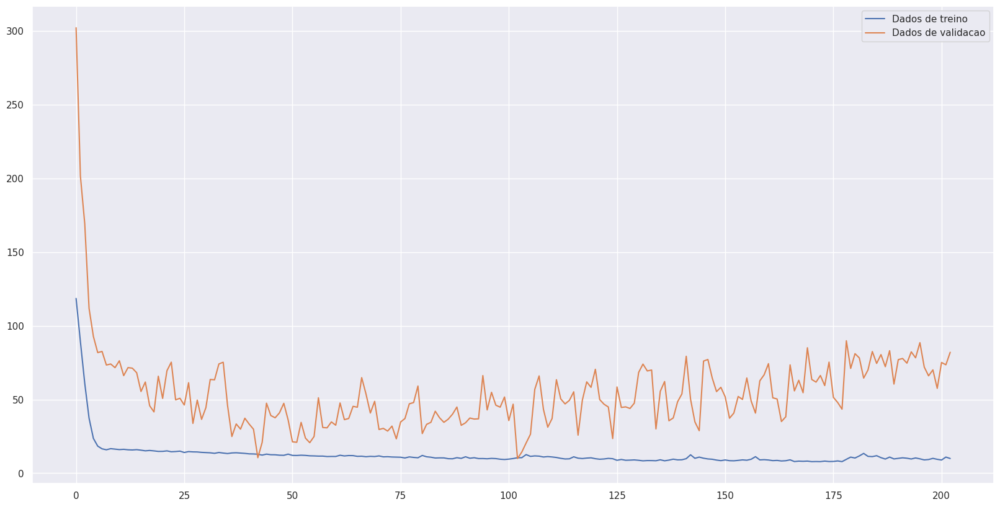

In [72]:
#Pegando o erro e validacao
lista_treino = []
lista_validacao = []
for i in range(len(modelo_torch.history)):
  lista_treino.append(modelo_torch.history[i]['train_loss'])
  lista_validacao.append(modelo_torch.history[i]['valid_loss'])
plt.plot(range(len(lista_treino)),lista_treino,label='Dados de treino')
plt.plot(range(len(modelo_torch.history)),lista_validacao,label='Dados de validacao')
plt.legend()

###Avaliando os residuos dos medelos

https://medium.com/@krzysztofdrelczuk/acf-autocorrelation-function-simple-explanation-with-python-example-492484c32711

####Regressao lasso


In [73]:
predic_treino_lasso = lasso.predict(x_treino)

In [74]:
predic_treino_lasso

array([18.22844572, 17.8122183 , 16.40323322, 16.05875745, 16.35370163,
       16.47517183, 16.40065516, 15.96826211, 15.05938575, 14.7582637 ,
       15.16253855, 16.10638205, 16.6990582 , 17.6638755 , 19.09399469,
       19.43808017, 19.16131051, 18.90950075, 18.97219822, 18.93399593,
       18.94899476, 18.80954774, 18.4776231 , 18.1217858 , 18.24092004,
       18.03034547, 18.070502  , 17.80786249, 17.91760695, 20.32011355,
       22.44022394, 24.46064379, 26.31807347, 26.56819699, 26.66951616,
       26.30600465, 26.02861716, 25.7308622 , 24.71167697, 22.46384381,
       19.44732859, 18.0649611 , 17.20199289, 16.06148296, 15.64882222,
       15.99141968, 16.09569391, 15.95064205, 15.69045253, 15.80339834,
       15.84421807, 15.92210939, 16.20988448, 16.56925776, 17.26241635,
       17.83253191, 18.21965327, 18.71518168, 19.23604312, 19.59152983,
       19.78718053, 19.7152727 , 19.5671493 , 19.53771891, 19.4069593 ,
       18.98856689, 18.49589419, 17.85147287, 17.19040596, 16.83

In [75]:
residuo_lasso = y_treino - predic_treino_lasso

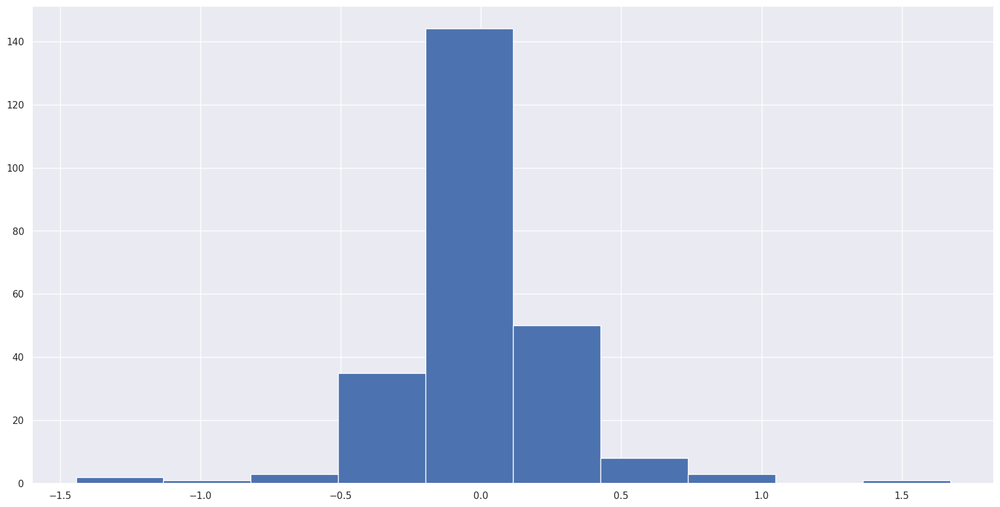

In [76]:
plt.hist(residuo_lasso);

In [77]:
import statsmodels.api as sm

Gráfico ACF de resíduos
Com dados de séries temporais, é altamente provável que o valor de uma variável observada no período de tempo atual seja semelhante ao seu valor no período anterior, ou mesmo no período anterior a esse, e assim por diante. Portanto, ao ajustar um modelo de regressão a dados de séries temporais, é comum encontrar autocorrelação nos resíduos. Nesse caso, o modelo estimado viola a suposição de não haver autocorrelação nos erros, e nossas previsões podem ser ineficientes — sobra alguma informação que deve ser contabilizada no modelo para obter melhores previsões. As previsões de um modelo com erros autocorrelacionados ainda não são viesadas e, portanto, não estão “erradas”, mas geralmente terão intervalos de previsão maiores do que o necessário. Portanto, devemos sempre olhar para um gráfico ACF dos resíduos.

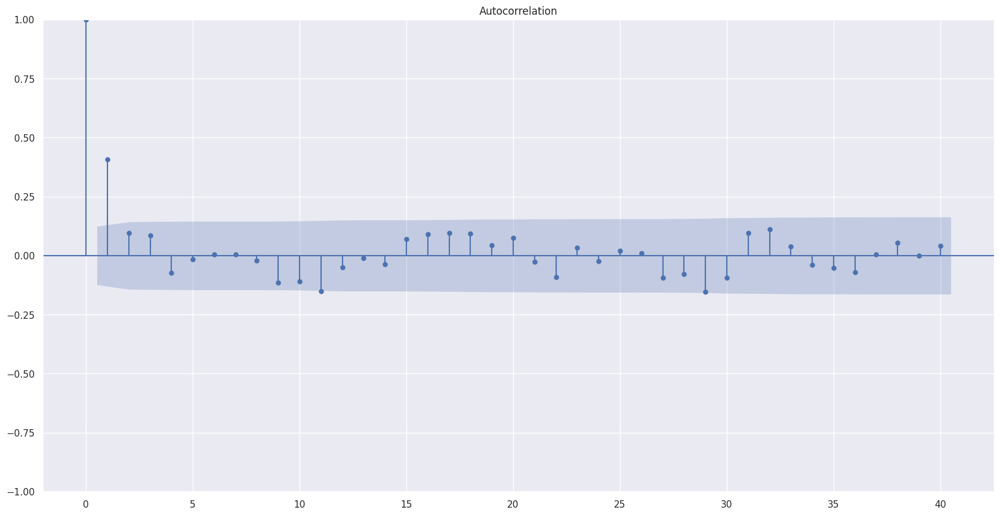

In [78]:
sm.graphics.tsa.plot_acf(residuo_lasso,lags=40)
plt.show()

####Random forest
RandomForestRegressor(max_depth=100, max_features=15, min_samples_leaf=4,
                      min_samples_split=8, n_estimators=20)

In [79]:
predic_rando_treino = rfr.predict(x_treino)

In [80]:
residuo_random = y_treino-predic_rando_treino

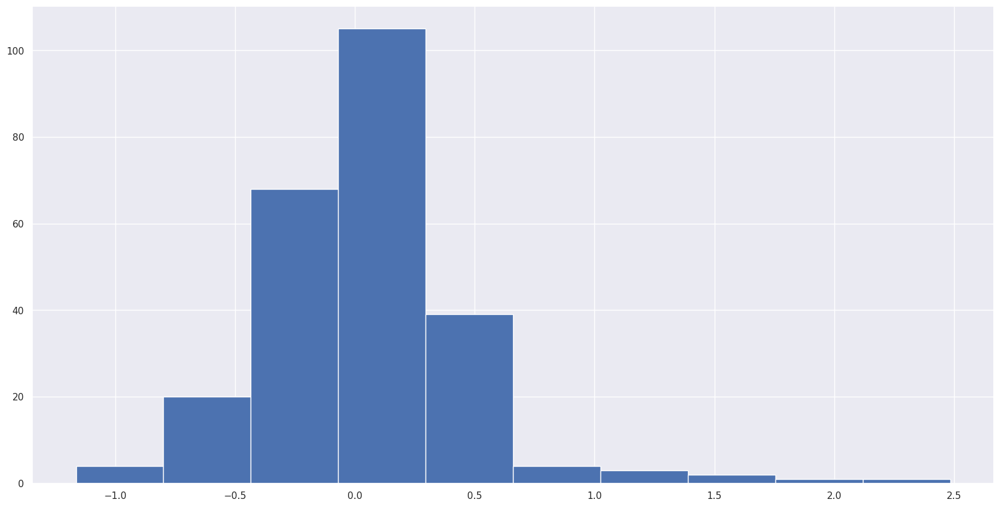

In [81]:
plt.hist(residuo_random);

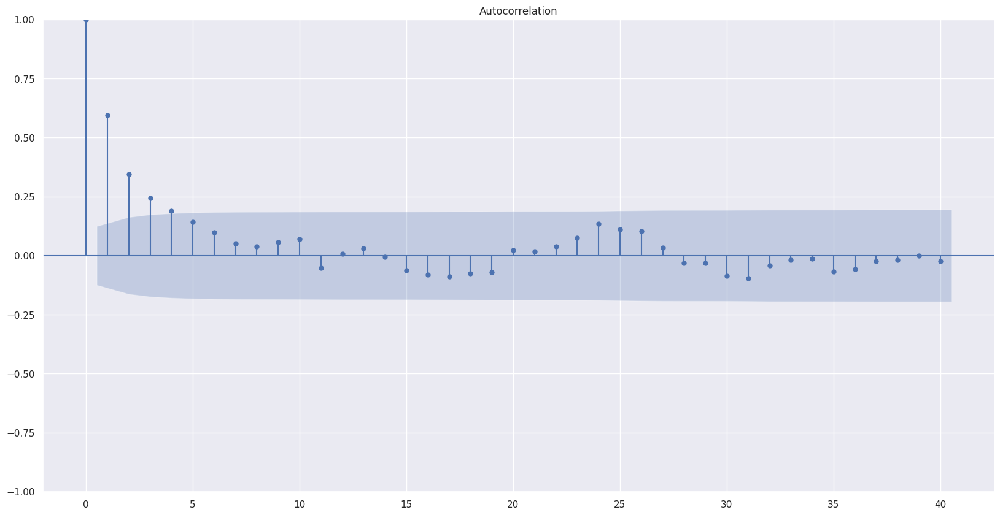

In [82]:
sm.graphics.tsa.plot_acf(residuo_random,lags=40)
plt.show()

####Gradiente Boosting


In [83]:
predict_grad_treino = grad_bost.predict(x_treino)

In [84]:
residuo_grad = y_treino - predict_grad_treino

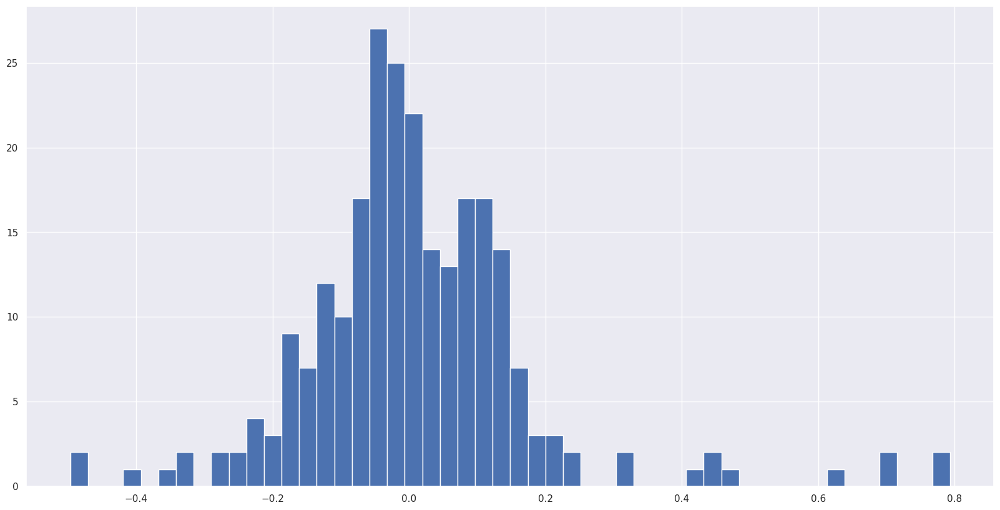

In [85]:
plt.hist(residuo_grad,bins=50);

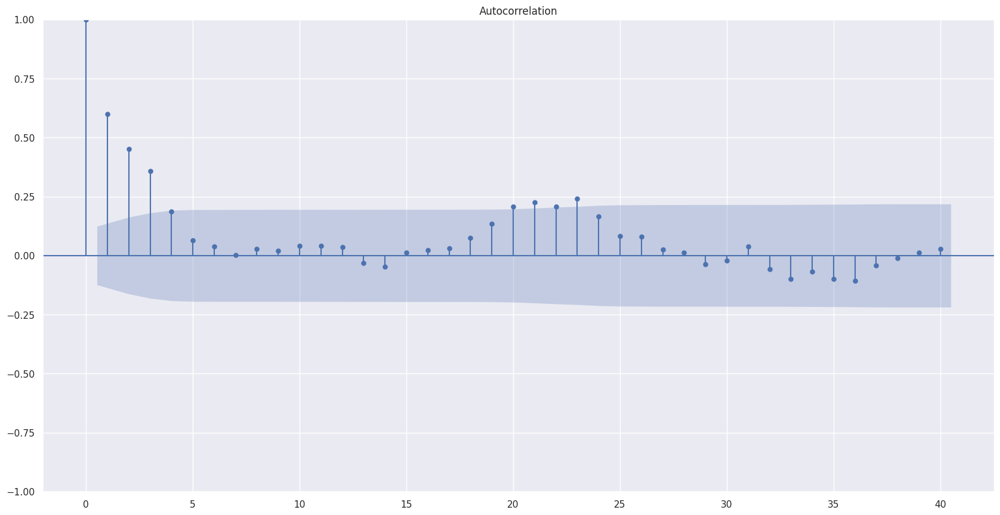

In [86]:
sm.graphics.tsa.plot_acf(residuo_grad,lags=40)
plt.show()

####Redes neurais Tensor Flow

In [87]:
predict_redes_treino = model.predict(x_treino)

8/8 [==============================] - 1s 4ms/step


In [88]:
#Retirando um dimensao do array
predict_redes_treino = np.squeeze(predict_redes_treino)
predict_redes_treino

array([16.644938 , 16.206066 , 15.784306 , 15.469547 , 15.453676 ,
       15.49954  , 15.051884 , 14.971262 , 14.679207 , 14.884932 ,
       15.165743 , 15.697395 , 16.174381 , 17.501207 , 17.75615  ,
       18.011969 , 18.092936 , 17.877558 , 17.919277 , 18.024622 ,
       17.705658 , 17.780382 , 17.626375 , 17.36106  , 16.531063 ,
       16.609158 , 16.852312 , 17.21703  , 17.89429  , 19.410719 ,
       20.975424 , 23.832163 , 25.821264 , 26.277468 , 26.204798 ,
       25.491846 , 24.738424 , 24.329218 , 22.610704 , 21.004438 ,
       19.15972  , 17.958574 , 16.605953 , 15.603754 , 15.3470745,
       15.323137 , 15.159012 , 15.257128 , 15.123896 , 14.846985 ,
       15.241638 , 15.1901   , 15.523872 , 15.999886 , 16.58854  ,
       16.999487 , 17.715363 , 18.000147 , 18.246395 , 18.053446 ,
       18.688803 , 18.375925 , 18.096588 , 18.09047  , 17.796703 ,
       17.761408 , 17.64277  , 16.64521  , 16.44869  , 16.019337 ,
       15.343021 , 15.203835 , 14.9147415, 14.44754  , 14.2046

In [89]:
residuo_neurais = y_treino - predict_redes_treino

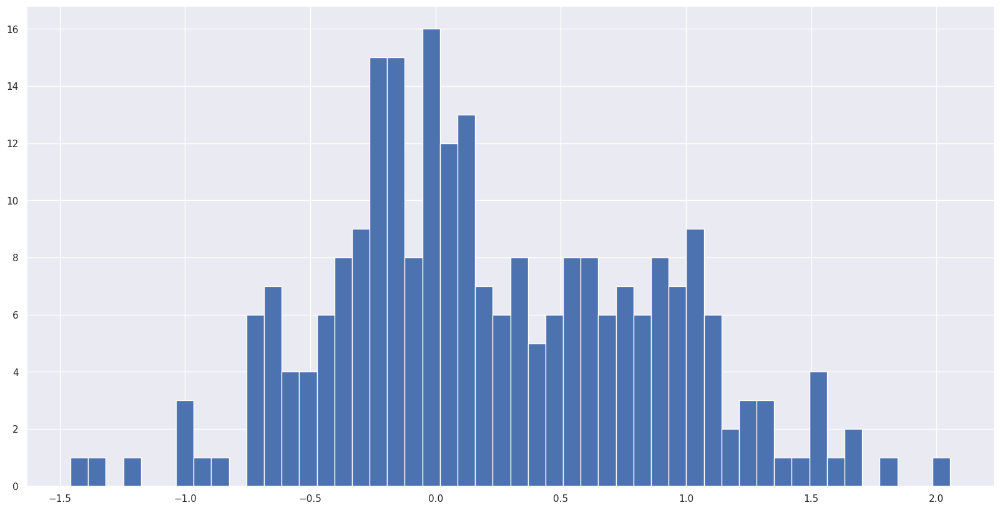

In [90]:
plt.hist(residuo_neurais,bins=50);

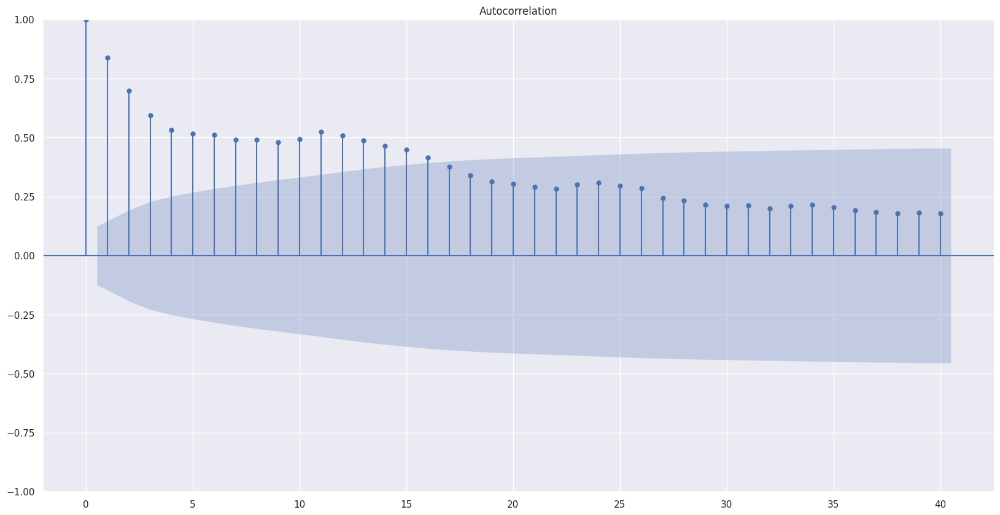

In [91]:
sm.graphics.tsa.plot_acf(residuo_neurais,lags=40)
plt.show()

#### Redes neurais Pytorch

In [92]:
#with torch.no_grad():
#modelo.eval()
#predi_pytorch_treino = modelo(torch.Tensor(x_treino)).numpy().flatten().tolist()



In [93]:
x_treino_tensor.shape

torch.Size([247, 79])

In [94]:
predi_pytorch_treino = modelo_torch.predict(x_treino_tensor).squeeze().tolist()

In [95]:
residuo_pytorch = y_treino - predi_pytorch_treino

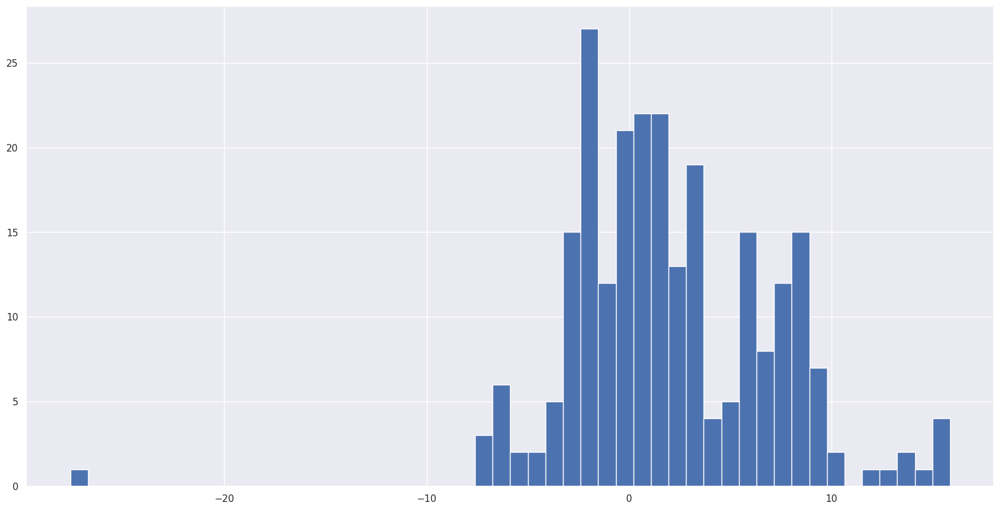

In [96]:
plt.hist(residuo_pytorch,bins=50);

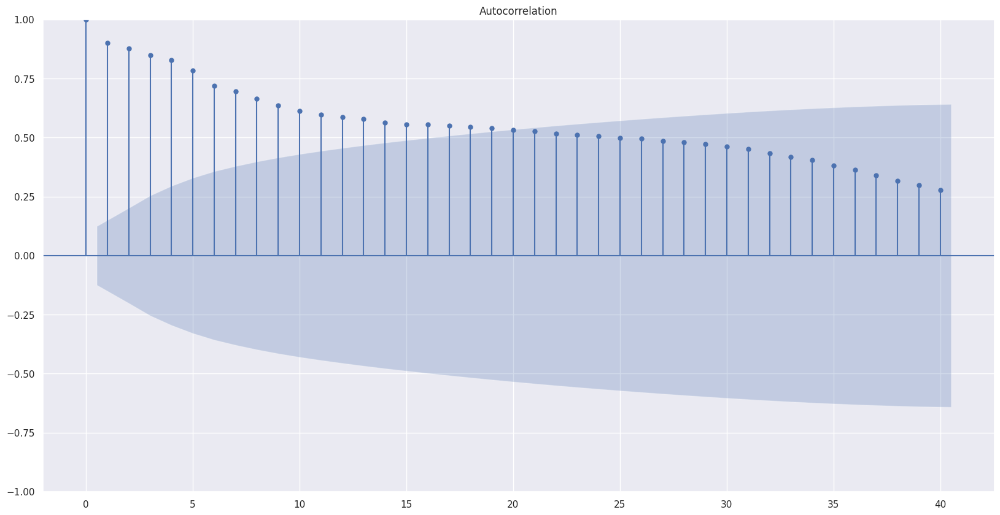

In [97]:
sm.graphics.tsa.plot_acf(residuo_pytorch,lags=40)
plt.show()


###Avaliando os dados de treino

In [98]:
metrics_random_treino = evaluate_regression(y_treino,predic_rando_treino, 'Random Forest Regression')
metrics_linear_treino = evaluate_regression(y_treino,predic_treino_lasso, 'Linear Regression')
metrics_grad_treino = evaluate_regression(y_treino,predict_grad_treino, 'Gradiente Boosting Regression')
metrics_redes_treino = evaluate_regression(y_treino,predict_redes_treino, 'Redes Neurais')
metrics_torch_treino = evaluate_regression(y_treino,predi_pytorch_treino,'Pytorch')
metrics_treino = pd.concat([metrics_random_treino, metrics_linear_treino,metrics_grad_treino,metrics_redes_treino,metrics_torch_treino])
metrics_treino

,MAE,MSE,RMSE,R²
Random Forest Regression,0.30,0.20,0.44,0.99
Linear Regression,0.18,0.08,0.28,1.00
Gradiente Boosting Regression,0.11,0.03,0.17,1.00
Redes Neurais,0.53,0.47,0.68,0.98
Pytorch,4.02,30.01,5.48,-0.17


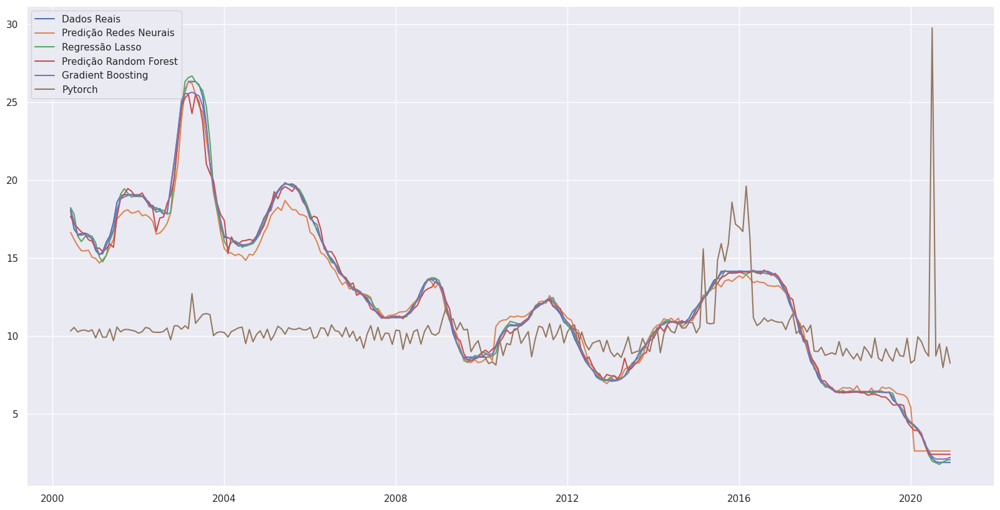

In [99]:
#Plotando as predicoes
plt.plot(treino.index,y_treino,label='Dados Reais')
plt.plot(treino.index,predict_redes_treino,label='Predição Redes Neurais')
plt.plot(treino.index,predic_treino_lasso,label='Regressão Lasso')
plt.plot(treino.index,predic_rando_treino,label='Predição Random Forest')
plt.plot(treino.index,predict_grad_treino,label='Gradient Boosting')
plt.plot(treino.index,predi_pytorch_treino,label='Pytorch')
plt.legend();

###Avaliando nos dados de teste

In [100]:
predic_teste_lasso = lasso.predict(x_teste)

In [101]:
predic_rando_teste = rfr.predict(x_teste)

In [102]:
predict_grad_teste = grad_bost.predict(x_teste)

In [103]:
predict_redes_teste = model.predict(x_teste)

1/1 [==============================] - 0s 31ms/step


In [104]:
x_teste_tensor = torch.Tensor(x_teste)
predi_pytorch_teste = modelo_torch.predict(x_teste_tensor).squeeze().tolist()


In [105]:
metrics_random_teste = evaluate_regression(y_teste,predic_rando_teste, 'Random Forest Regression')
metrics_linear_teste = evaluate_regression(y_teste,predic_teste_lasso, 'Linear Regression')
metrics_grad_teste = evaluate_regression(y_teste,predict_grad_teste, 'Gradiente Boosting Regression')
metrics_redes_teste = evaluate_regression(y_teste,predict_redes_teste, 'Redes Neurais')
metrics_pytorch_teste = evaluate_regression(y_teste,predi_pytorch_teste, 'Pytorch')
metrics_teste = pd.concat([metrics_random_teste, metrics_linear_teste,metrics_grad_teste,metrics_redes_teste,metrics_pytorch_teste])
metrics_teste

,MAE,MSE,RMSE,R²
Random Forest Regression,1.22,1.96,1.40,0.90
Linear Regression,0.19,0.07,0.27,1.00
Gradiente Boosting Regression,0.62,0.73,0.85,0.96
Redes Neurais,0.71,1.01,1.01,0.95
Pytorch,3.30,13.44,3.67,0.33


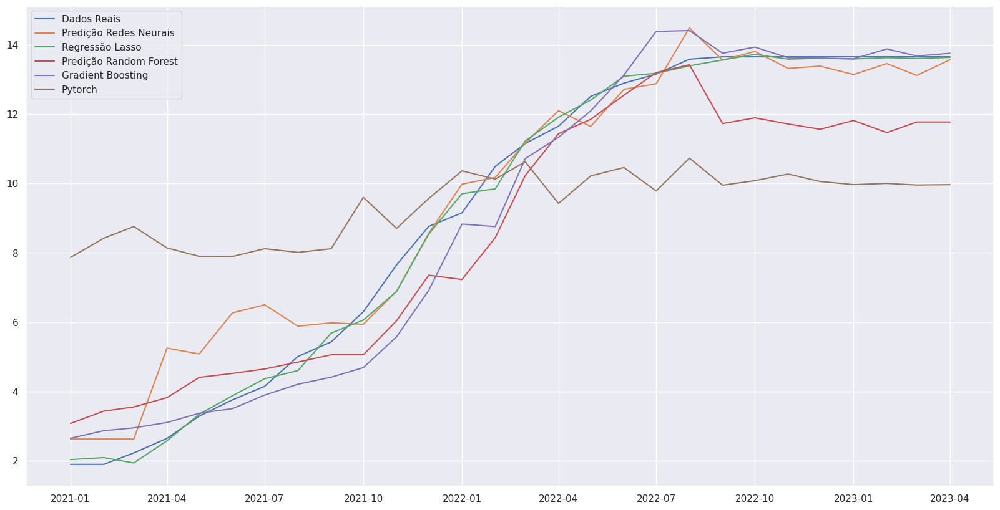

In [106]:
#Plotando as predicoes
plt.plot(teste.index,y_teste,label='Dados Reais')
plt.plot(teste.index,predict_redes_teste,label='Predição Redes Neurais')
plt.plot(teste.index,predic_teste_lasso,label='Regressão Lasso')
plt.plot(teste.index,predic_rando_teste,label='Predição Random Forest')
plt.plot(teste.index,predict_grad_teste,label='Gradient Boosting')
plt.plot(teste.index,predi_pytorch_teste,label='Pytorch')
plt.legend();

In [107]:
import plotly.graph_objs as go

# Crie um objeto de figura
fig = go.Figure()

fig.update_layout(
    height=1000, # altura em pixels
    width=2000, # largura em pixels
)

# Adicione a série temporal real ao gráfico
fig.add_trace(go.Scatter(x=teste.index, y=y_teste, name='Dados Reais'))

# Adicione as previsões de cada modelo ao gráfico
fig.add_trace(go.Scatter(x=teste.index, y=predict_redes_teste, name='Predição Redes Neurais'))
fig.add_trace(go.Scatter(x=teste.index, y=predic_teste_lasso, name='Regressão Lasso'))
fig.add_trace(go.Scatter(x=teste.index, y=predic_rando_teste, name='Predição Random Forest'))
fig.add_trace(go.Scatter(x=teste.index, y=predict_grad_teste, name='Gradient Boosting'))
fig.add_trace(go.Scatter(x=teste.index, y=predi_pytorch_teste, name='Pytorch'))

# Adicione um título e etiquetas aos eixos
fig.update_layout(title='Previsões de diferentes modelos',
                   xaxis_title='Data',
                   yaxis_title='Valor')

# Mostre o gráfico
fig.show()


###Intervalo de previsao

In [108]:
def intervalo_predicao_bootstraps(x_treino,y_treino,modelo_treinado,x_teste,index,predicao,nome_algoritimo,percentiles = [2.5, 97.5],n_bootstraps=1000):
  import numpy as np
  from sklearn.utils import resample

  # Bootstrap
  n_samples = len(x_treino)
  bootstrapped_predictions = np.zeros((n_bootstraps, len(x_teste)))
  
  if nome_algoritimo == 'Redes Neurais':
    for i in range(n_bootstraps):
      bootstrapped_data = resample(np.column_stack((x_treino, y_treino)), replace=True, n_samples=n_samples, random_state=i)
      bootstrapped_x_train, bootstrapped_y_train = bootstrapped_data[:, :-1], bootstrapped_data[:, -1]
      bootstrapped_model = modelo_treinado.fit(bootstrapped_x_train, bootstrapped_y_train, epochs=100,batch_size=100,verbose=0)
      bootstrapped_predictions[i] = np.squeeze(model.predict(x_teste))
  else:
    for i in range(n_bootstraps):
      bootstrapped_data = resample(np.column_stack((x_treino, y_treino)), replace=True, n_samples=n_samples, random_state=i)
      bootstrapped_x_train, bootstrapped_y_train = bootstrapped_data[:, :-1], bootstrapped_data[:, -1]
      bootstrapped_model = modelo_treinado.fit(bootstrapped_x_train, bootstrapped_y_train)
      bootstrapped_predictions[i] = bootstrapped_model.predict(x_teste)

  # Calcula intervalos de previsão
  lower = np.percentile(bootstrapped_predictions, percentiles[0], axis=0)
  upper = np.percentile(bootstrapped_predictions, percentiles[1], axis=0)

  intervalos = pd.DataFrame(index=index)
  intervalos['Predicao'] = predicao
  intervalos[f'lower({percentiles[0]})'] = lower
  intervalos[f'upper({percentiles[1]})'] = upper

  import matplotlib.pyplot as plt

  plt.plot(index,predicao,'*')
  plt.fill_between(index,lower, upper, color='gray', alpha=0.5, label=f'Intervalo de confiança de {percentiles[1]-percentiles[0]}%')
  plt.legend()
  plt.xlabel('Datas')
  plt.ylabel('Predição')
  plt.title('Previsões com intervalo de confiança para a'+' '+nome_algoritimo)
  plt.show()
  return intervalos

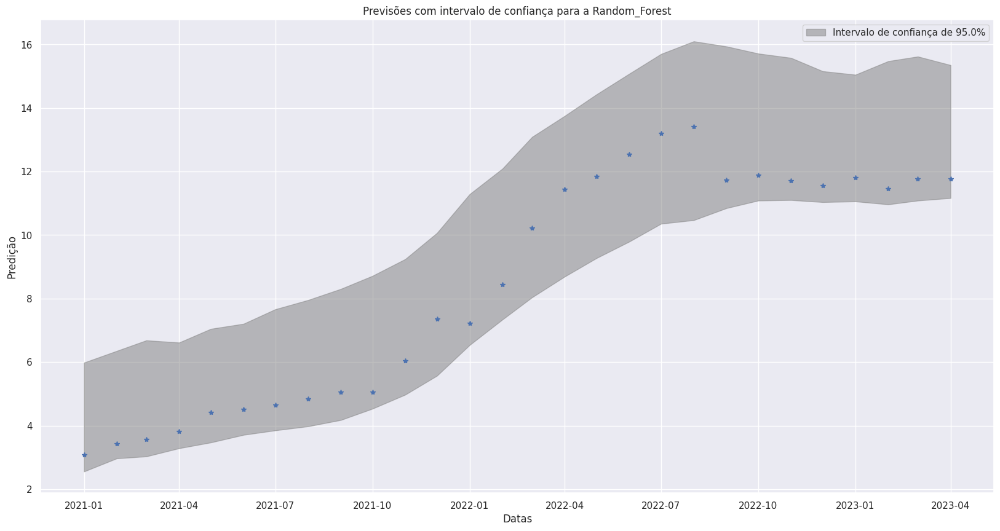

In [109]:
intervalo_random = intervalo_predicao_bootstraps(x_treino,y_treino,rfr,x_teste,teste.index,predic_rando_teste,'Random_Forest')

In [110]:
intervalo_random

,Predicao,lower(2.5),upper(97.5)
2021-01-01,3.08,2.55,5.98
2021-02-01,3.43,2.97,6.35
2021-03-01,3.56,3.03,6.68
2021-04-01,3.82,3.29,6.61
2021-05-01,4.41,3.47,7.05
2021-06-01,4.52,3.71,7.21
2021-07-01,4.65,3.85,7.66
2021-08-01,4.85,3.98,7.95
2021-09-01,5.06,4.18,8.30
2021-10-01,5.06,4.53,8.72


/usr/local/lib/python3.9/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.211e-01, tolerance: 5.863e-01

/usr/local/lib/python3.9/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.876e-01, tolerance: 6.978e-01

/usr/local/lib/python3.9/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.938e-01, tolerance: 7.965e-01

/usr/local/lib/python3.9/dist-packages/sklearn/linear_model/_coordinate_descent

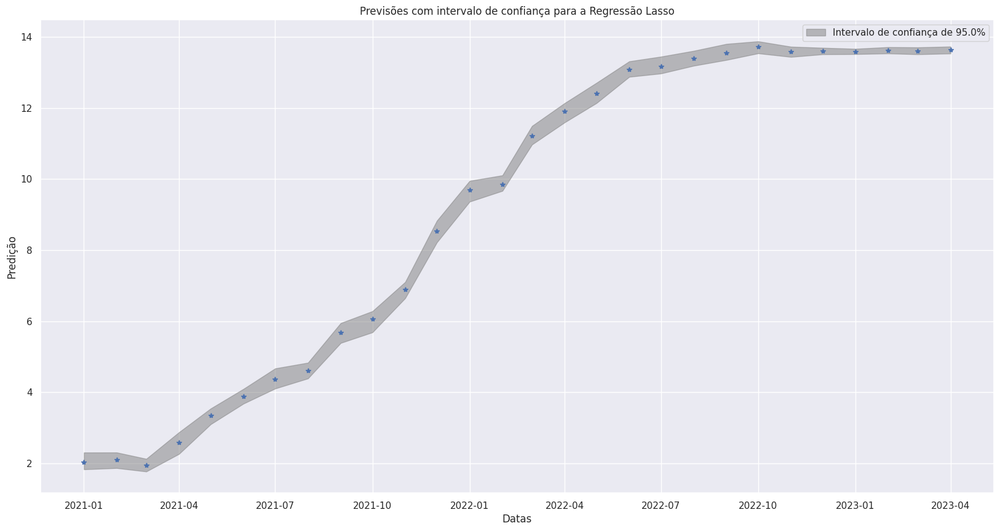

In [111]:
intervalo_lasso = intervalo_predicao_bootstraps(x_treino,y_treino,lasso,x_teste,teste.index,predic_teste_lasso,'Regressão Lasso')

In [112]:
intervalo_lasso

,Predicao,lower(2.5),upper(97.5)
2021-01-01,2.04,1.83,2.30
2021-02-01,2.10,1.87,2.31
2021-03-01,1.94,1.77,2.13
2021-04-01,2.58,2.26,2.88
2021-05-01,3.35,3.10,3.54
2021-06-01,3.88,3.68,4.09
2021-07-01,4.37,4.10,4.67
2021-08-01,4.60,4.39,4.83
2021-09-01,5.68,5.39,5.95
2021-10-01,6.06,5.69,6.28


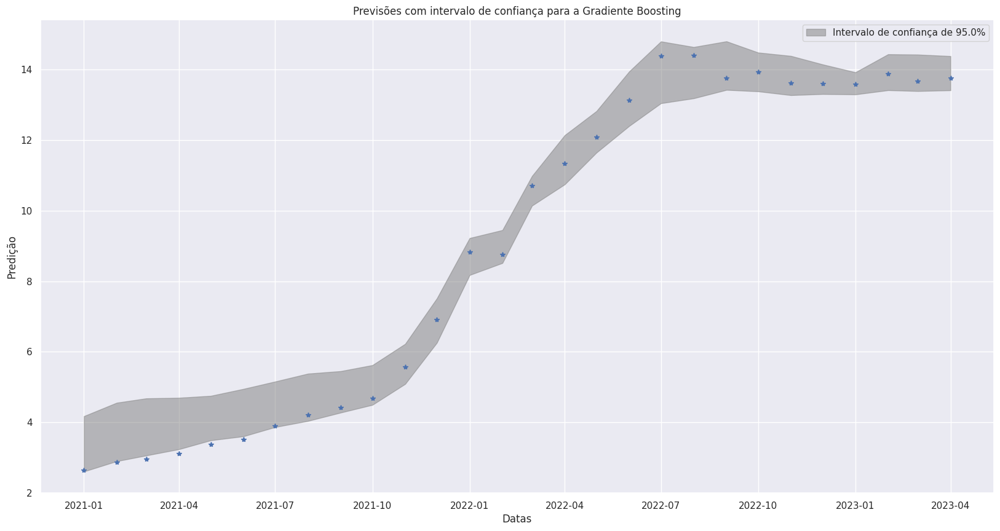

In [113]:
intervalo_grad = intervalo_predicao_bootstraps(x_treino,y_treino,grad_bost,x_teste,teste.index,predict_grad_teste,'Gradiente Boosting',n_bootstraps=100)

In [114]:
intervalo_grad

,Predicao,lower(2.5),upper(97.5)
2021-01-01,2.65,2.60,4.17
2021-02-01,2.87,2.90,4.55
2021-03-01,2.95,3.06,4.68
2021-04-01,3.11,3.24,4.70
2021-05-01,3.37,3.49,4.75
2021-06-01,3.51,3.60,4.95
2021-07-01,3.90,3.86,5.16
2021-08-01,4.21,4.04,5.38
2021-09-01,4.41,4.27,5.45
2021-10-01,4.69,4.49,5.62


1/1 [==============================] - 0s 29ms/step


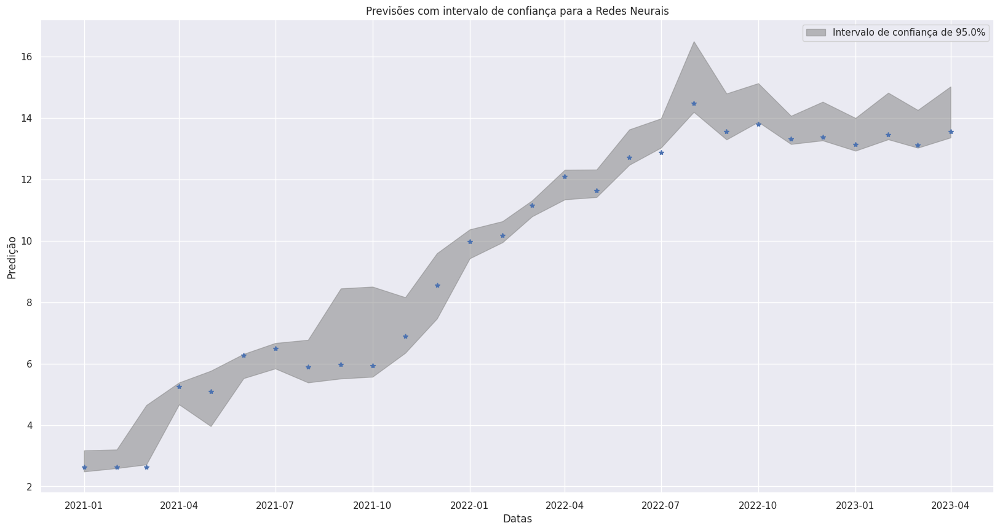

In [115]:
intervalo_redes = intervalo_predicao_bootstraps(x_treino,y_treino,model,x_teste,teste.index,predict_redes_teste,'Redes Neurais',n_bootstraps=20)

In [116]:
intervalo_redes

,Predicao,lower(2.5),upper(97.5)
2021-01-01,2.63,2.49,3.17
2021-02-01,2.63,2.59,3.20
2021-03-01,2.63,2.71,4.65
2021-04-01,5.25,4.67,5.38
2021-05-01,5.08,3.96,5.76
2021-06-01,6.27,5.52,6.31
2021-07-01,6.50,5.84,6.67
2021-08-01,5.88,5.38,6.77
2021-09-01,5.98,5.51,8.45
2021-10-01,5.94,5.57,8.50


#Criando modelo Trimestral

##Tratando os dados

###Transformando os dados em trimestrais

In [ ]:
dados_trimestrais = dados.resample('QS').mean()
dados_trimestrais

In [ ]:
dados_trimestrais.drop(['pib_mensal','consumo_publica_mensal','formacao_bruta_mensal'],axis=1,inplace=True)

In [ ]:
dados_trimestrais['formacao_bruta_trimestral'] = formacao_bruta['formacao_bruta']
dados_trimestrais['pib_trimestral'] = pib['pib']
dados_trimestrais['consumo_publica'] = consumo_publica['consumo_publica']

In [ ]:
dados_trimestrais

In [ ]:
dados_trimestrais.isnull().sum()

In [ ]:
plotar(dados_trimestrais)

###Criando dummy Covid para as 2020-04-01 e 2020-05-01

In [ ]:
dados_trimestrais['dummy_covid'] = np.where((dados_trimestrais.index >= pd.to_datetime('2020-04-01')) & (dados_trimestrais.index <= pd.to_datetime('2020-05-01')), 1,0)
dados_trimestrais

###Fazendo Backcasting nos valores faltantes com arvores de decisao

In [ ]:
dados_interpolacao =dados_trimestrais.copy()

In [ ]:
from sklearn.tree import DecisionTreeRegressor
from xgboost import XGBRegressor

In [ ]:
colunas=dados_trimestrais.columns.tolist()

In [ ]:
np.random.seed(0)
dados_bac = dados_trimestrais.copy()
for i in colunas:
    dados_interpolacao = dados_trimestrais.copy()

    dados_interpolacao = dados_interpolacao.loc[:dados_interpolacao[i].last_valid_index()]


    # Separate values not NaN and NaN in two different dataframes
    treino_interpolacao = dados_interpolacao[dados_interpolacao[i].notnull()]
    predicao_interpolacao = dados_interpolacao[dados_interpolacao[i].isnull()]
  
    # Create Y_treino column and remove from treino_interpolacao
    Y_treino = treino_interpolacao[i]
    treino_interpolacao = treino_interpolacao.drop(i,axis=1)

    predicao_interpolacao = predicao_interpolacao.drop(i,axis=1)
    
    # Remove columns with more than 10 NaN values
    predicao_interpolacao = predicao_interpolacao.dropna(thresh=len(predicao_interpolacao) - 4, axis=1)

    Y_treino = Y_treino[Y_treino.index.isin(treino_interpolacao.index)]

    treino_interpolacao = treino_interpolacao.loc[:, predicao_interpolacao.columns]

   # Fill NaN values in remaining columns with the mean
    treino_interpolacao = treino_interpolacao.fillna(treino_interpolacao.mean())
    predicao_interpolacao = predicao_interpolacao.fillna(predicao_interpolacao.mean())
   # Filter prediction dataframe to include only columns present in training dataframe
   # Create the model
    model = XGBRegressor(random_state=0)
   
   # Train the model
    model.fit(treino_interpolacao.values,Y_treino.values.reshape(-1,1))
    predicao = model.predict(predicao_interpolacao.values)
    interpolados= pd.DataFrame(predicao,index=predicao_interpolacao.index)
    try:
      interpolados.columns = [i]
      dados_bac.fillna(interpolados,inplace=True)
    except:
      dados_bac[i] = dados_trimestrais[i]

In [ ]:
dados_bac

In [ ]:
dados_bac

In [ ]:
for i in dados_trimestrais.columns:
  plt.plot(dados_bac[i])
  plt.plot(dados_trimestrais[i])
  plt.title(i)
  plt.show()

###Estacionaridade
A TS é dita estacionária se as suas propriedades estatísticas, tais como a média e variância permanecem constantes ao longo do tempo. Mas por que isso é importante? A maioria dos modelos TS trabalha com o pressuposto de que a TS é estacionária. Intuitivamente, podemos entender que se uma TS tem um comportamento particular ao longo de um tempo, há uma probabilidade muito elevada de que seguirá o mesmo comportamento no futuro. Além disso, as teorias relacionadas com séries estacionárias são mais maduras e mais fáceis de implementar, em comparação com séries não-estacionárias.

https://www.vooo.pro/insights/guia-completo-para-criar-time-series-com-codigo-em-python/

In [ ]:
def plotar(dados):
  for i in range(len(dados.columns)):
    fig, ax = plt.subplots(dpi=120)
    ax.plot(dados.iloc[:,i],label=dados.columns[i])
    plt.legend()
    plt.show()

#####Teste de estacionaridade Dickey-Fuller
Dickey-Fuller teste: esse é um dos testes estatísticos para verificar Estacionaridade. Aqui, a hipótese nula é que o TS é não-estacionária. Os resultados do teste são compostos por uma estatística de teste e alguns valores críticos para os níveis de confiança da diferença. Se o ‘teste estatístico’ é menor do que o “valor crítico”, podemos rejeitar a hipótese nula e dizer que a série é estacionária. Consulte este artigo para obter detalhes.

In [ ]:
def test_kpss_adf(dados):
  #https://www.statsmodels.org/dev/examples/notebooks/generated/stationarity_detrending_adf_kpss.html
  def kpss_test(timeseries):
    """
    O KPSS é outro teste para verificar a estacionaridade de uma série temporal. As hipóteses nula e alternativa para o teste KPSS são opostas às do teste ADF.

    Hipótese Nula: O processo é estacionário de tendência.

    Hipótese Alternativa: A série tem raiz unitária (a série não é estacionária).

    Uma função é criada para realizar o teste KPSS em uma série temporal.
    """
    #print("Results of KPSS Test:")
    kpsstest = kpss(timeseries, regression="c", nlags="auto")
    kpss_output = pd.Series(
      kpsstest[0:3], index=["Test Statistic", "p-value", "Lags Used"]
    )
    for key, value in kpsstest[3].items():
        kpss_output["Critical Value (%s)" % key] = value
    return kpss_output

  def adf_test(timeseries):

    """
    O teste ADF é usado para determinar a presença de raiz unitária na série e, portanto, ajuda a entender se a série é estacionária ou não. As hipóteses nula e 
    alternativa deste teste são:
    Hipótese Nula: A série tem raiz unitária.
    Hipótese alternativa: A série não tem raiz unitária.
    Se a hipótese nula não for rejeitada, este teste pode fornecer evidências de que a série é não estacionária.
   Uma função é criada para realizar o teste ADF em uma série temporal.
    """
    #print("Results of Dickey-Fuller Test:")
    dftest = adfuller(timeseries, autolag="AIC")
    dfoutput = pd.Series(
      dftest[0:4],
      index=[
            "Test Statistic",
            "p-value",
            "#Lags Used",
            "Number of Observations Used",
        ],
    )
    for key, value in dftest[4].items():
      dfoutput["Critical Value (%s)" % key] = value
    return dfoutput


  test_est = pd.DataFrame(index=dados.columns,columns = ['Teste_kpss', 'Estacionaria_ou_nâo_kpss','Teste_adf','Estacionaria_ou_nâo_adf'])
  for k in dados.columns:
    tes_kpss = kpss_test(dados[k].dropna())
    test_est.loc[k,test_est.columns[0]] = tes_kpss[1]
    tes_adf = adf_test(dados[k].dropna())
    test_est.loc[k,test_est.columns[2]] = tes_adf[1]
  test_est['Estacionaria_ou_nâo_kpss']=np.where(test_est['Teste_kpss'] >= 0.05,'Estacionaria','Nâo estacionaria')
  test_est['Estacionaria_ou_nâo_adf']=np.where(test_est['Teste_adf'] <= 0.05,'Estacionaria','Nâo estacionaria')
  return test_est
  

In [ ]:
from statsmodels.tsa.stattools import adfuller
def test_stationarity(timeseries,plot=True):
    from statsmodels.tsa.stattools import adfuller
    import pandas as pd
    import matplotlib.pylab as plt
    import seaborn as sns
    import numpy as np
    if plot == True:
      for i in range(len(timeseries.columns)):
      #Determing rolling statistics
        rolmean = pd.Series(timeseries.iloc[:,i]).rolling(window=12).mean().dropna()
        rolstd = pd.Series(timeseries.iloc[:,i]).rolling(window=12).std().dropna()
      #Plot rolling statistics:
        orig = plt.plot(timeseries.iloc[:,i], color='blue',label='Original')
        mean = plt.plot(rolmean, color='red', label='Rolling Mean')
        std = plt.plot(rolstd, color='black', label = 'Rolling Std')
        plt.legend(loc='best')
        plt.title(f'Rolling Mean & Standard Deviation na variavel {timeseries.columns[i]}')
        plt.show(block=False)
    
        #Perform Dickey-Fuller test:
        print (f'Results of Dickey-Fuller Test:Coluna {timeseries.columns[i]}')
        dftest = adfuller(timeseries.iloc[:,i].dropna(), autolag='AIC')
        dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
        for key,value in dftest[4].items():
          dfoutput['Critical Value (%s)'%key] = value
        print(dfoutput)
    else:
      None
    return test_kpss_adf(timeseries)

In [ ]:
test = test_stationarity(dados_bac)

In [ ]:
test

#####Verificando a diferenca de estacionaridade
#http://alkaline-ml.com/pmdarima/1.5.1/modules/generated/pmdarima.arima.ndiffs.html

In [ ]:
from pmdarima import arima

In [ ]:
def report_ndiffs (dados,test=['kpss','adf', 'pp'],alpha=0.05):
  dat_ndifis = pd.DataFrame(index=dados.columns)
  for i in test:
    dat_n = []
    for j in dados.columns:
      try:
        dat_n.append(arima.ndiffs(dados[j].dropna(),alpha,test=i))
      except:
        dat_n.append(0)
    dat_ndifis[i] = dat_n
  result = []
  for k in range(len(dat_ndifis)):
    result.append(np.where(dat_ndifis.iloc[k,0]==dat_ndifis.iloc[k,1],dat_ndifis.iloc[k,0],
         np.where(dat_ndifis.iloc[k,1]==dat_ndifis.iloc[k,2],dat_ndifis.iloc[k,1],
                  np.where(dat_ndifis.iloc[k,0]==dat_ndifis.iloc[k,2],dat_ndifis.iloc[k,2],
                  np.where(dat_ndifis.iloc[k,0]!=dat_ndifis.iloc[k,1]!=dat_ndifis.iloc[k,2],dat_ndifis.iloc[k,0],'')))))
  dat_ndifis['Ndifis'] = result
  dat_ndifis.sort_values(by='Ndifis',ascending=False,inplace=True)
  dat_ndifis['Ndifis'] = dat_ndifis['Ndifis'].astype(int)
  return dat_ndifis

In [ ]:
n_difis = report_ndiffs(dados_bac)
n_difis

#####Ajustando dados nao estacionarios metodo de diferenciacao

https://www.youtube.com/watch?v=JuG8hwVK5uQ

Modelagem de séries temporais frequentemente exige a aplicação de transformações nas variáveis, tal como a bem conhecida primeira diferença. Formalmente, podemos descrever essa transformação como:


Ou seja, dado uma série temporal regularmente espaçada, subtraímos do valor em t o valor anterior (t-1), obtendo a série dita "na primeira diferença" ou "nas diferenças".

A mudança de nível da série geralmente contorna diversas características "não desejadas" pelo analista como tendência, sazonalidade, etc., mas dificulta a interpretação dos valores - especialmente quando pretende-se comunicá-los para públicos não técnicos. Para este objetivo é de grande utilidade saber como diferenciar uma série temporal e, sobretudo, também como reverter a transformação.

In [ ]:
def corrigindo_nao_estacionaridade(base,n_difis,valor_predicao):
  dados_est = base.copy()
  for i in n_difis[n_difis['Ndifis'] >= 1].index:
    if i == valor_predicao:
      dados_est[i] = dados_est[i]
    else:
      j = 0
      while j < n_difis['Ndifis'][i]:
        dados_est[i] = dados_est[i].diff(periods=1)
        j = j+1
  return dados_est

In [ ]:
dados_est = corrigindo_nao_estacionaridade(dados_bac,n_difis,'selic')[1:]
dados_fiferenca = report_ndiffs(dados_est)
dados_fiferenca

In [ ]:
##Eliminando dados faltantes
dados_est

In [ ]:
plotar(dados_est)

###Tratando dados faltantes

In [ ]:
dados_sem_faltante = dados_est.fillna(method='ffill')
dados_sem_faltante

###Epandir base criando defasagens

In [ ]:
def criando_defasagens(base,numero_defasagens=4):
  base_def = base.copy()
  for j in range(numero_defasagens):
    for i in base.columns:
      base_def[i+str('_lags_')+str(j+1)] = base_def[i].shift(j+1)
  return base_def

In [ ]:
dados_defasagens= criando_defasagens(dados_sem_faltante,4)[4:]
dados_defasagens

###Dividindo os dados em treino e teste

In [ ]:
treino = dados_defasagens[dados_defasagens.index < pd.to_datetime('2020-01-01')]

In [ ]:
treino

In [ ]:
y_treino = treino['selic'].values
x_treino = treino.loc[:,treino.columns != 'selic'].values

In [ ]:
teste = dados_defasagens[dados_defasagens.index >= pd.to_datetime('2020-01-01')]

In [ ]:
y_teste = teste['selic'].values
x_teste= teste.loc[:,teste.columns != 'selic'].values

In [ ]:
print('O tamanho do y_treino e ',y_treino.shape)
print('O tamanho do x_treino e ',x_treino.shape)
print('--------------------')
print('O tamanho do y_teste e ',y_teste.shape)
print('O tamanho do x_teste e ',x_teste.shape)
print('--------------------')

##Treinando os modelos

##Aplicando Grid Search


###Treinando o RandomForestRegressor

RandomForestRegressor(max_depth=30, max_features=23, min_samples_leaf=4,
                      min_samples_split=6, n_estimators=10)

In [ ]:
from scipy.stats import randint as sp_randint

In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint as sp_randint
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_squared_error, make_scorer
# definindo os hiperparâmetros
param_grid = {
  "n_estimators": [10, 20,50,60,100],
  "max_depth": [1,2,30,70,100],
  "min_samples_split": [2, 6,8,11],
  "min_samples_leaf": [1,4,9,11],
  "max_features": [1, 3,10,15,23],
  'criterion':['squared_error','absolute_error','friedman_mse']
}

# definição do RMSE como métrica de avaliação



# instanciando o modelo de random forest
rf = RandomForestRegressor()

# instanciando o randomized search
#random_search = RandomizedSearchCV(estimator=rf, param_distributions=param_grid, scoring= ['neg_root_mean_squared_error','neg_mean_absolute_percentage_error','neg_mean_absolute_error'], refit=False, cv=5, verbose=3)

search = GridSearchCV(estimator=rf, param_grid=param_grid, scoring= 'neg_root_mean_squared_error', cv=5, verbose=3)


# fit no modelo
search.fit(x_treino, y_treino)

# print dos melhores hiperparâmetros



In [ ]:
search.best_estimator_

###Treinando o Reggressao lasso

Model: Lasso
Best parameters: {'alpha': 0.02056136827353567}

In [ ]:
import numpy as np
import pandas as pd
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor

models = [LinearRegression(), Ridge(), Lasso()]
param_grid = [
    {'fit_intercept': [True, False]},
    {'alpha': np.logspace(-3, 3, 1000)},
    {'alpha': np.logspace(-3, 3, 1020)}]
for model, param_grid_model in zip(models, param_grid):
    grid_search = GridSearchCV(model, param_grid_model, scoring='neg_mean_squared_error', cv=5, return_train_score=True)
    grid_search.fit(x_treino, y_treino)
    print(f"Model: {type(model).__name__}")
    print(f"Best parameters: {grid_search.best_params_}")
    print(f"Best cross-validation score: {grid_search.best_score_}")
    print("")


### Treinando gradiente Bosting 

{'learning_rate': 0.1,
 'loss': 'huber',
 'max_depth': 3,
 'min_samples_leaf': 2,
 'min_samples_split': 2,
 'n_estimators': 500}

In [ ]:
y_teste

In [ ]:
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.model_selection import GridSearchCV
# instanciar o modelo de Gradient Boosting
model = GradientBoostingRegressor()

# definir os hiperparâmetros a serem testados
param_grid = {
    "loss":["ls", "lad", "huber", "quantile"],
    "learning_rate":[0.1, 0.05, 0.01],
    "n_estimators":[100, 250, 500],
    "max_depth":[3, 5, 7, 9],
    "min_samples_split":[2, 4, 8],
    "min_samples_leaf":[1, 2, 4]
}

# instanciar o GridSearchCV
grid_search = GridSearchCV(model, param_grid, cv=5, scoring='neg_mean_squared_error',verbose=3)

# fit no modelo
grid_search.fit(x_treino, y_treino)

# print dos melhores hiperparâmetros
print("Melhores hiperparâmetros: ", grid_search.best_params_)


In [ ]:
grid_search.best_params_

In [ ]:
grid_search.best_score_

##Treinando os modelos mensais com os melhores paramentros

In [ ]:
import numpy as np
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

def evaluate_regression(y_true, y_pred, algorithm):
    metrics = {}
    metrics['MAE'] = mean_absolute_error(y_true, y_pred)
    metrics['MSE'] = mean_squared_error(y_true, y_pred)
    metrics['RMSE'] = np.sqrt(metrics['MSE'])
    metrics['R²'] = r2_score(y_true, y_pred)
    metrics_df = pd.DataFrame(metrics, index=[algorithm])
    return metrics_df


In [ ]:
#'alpha': 0.6179759029126652
from sklearn.linear_model import LinearRegression, Ridge, Lasso
lasso = Lasso(random_state=0,alpha=0.02056136827353567)
lasso.fit(x_treino, y_treino)

In [ ]:
from sklearn.ensemble import RandomForestRegressor
rfr = RandomForestRegressor(max_depth=30, max_features=23, min_samples_leaf=4,
                      min_samples_split=6, n_estimators=10)
rfr.fit(x_treino, y_treino)

In [ ]:
{'learning_rate': 0.1,
 'loss': 'huber',
 'max_depth': 3,
 'min_samples_leaf': 2,
 'min_samples_split': 2,
 'n_estimators': 500}

In [ ]:
from sklearn.ensemble import GradientBoostingRegressor
grad_bost = GradientBoostingRegressor(random_state=0,learning_rate= 0.01, loss ='huber', max_depth= 3,min_samples_leaf=2, min_samples_split = 2, n_estimators = 500)
grad_bost.fit(x_treino, y_treino)

In [ ]:
import tensorflow as tf
model = tf.keras.models.Sequential()
model.add(tf.keras.layers.Dense(units=40, input_shape=(x_treino.shape[1],)))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Activation('relu'))
model.add(tf.keras.layers.Dropout(0.1))

model.add(tf.keras.layers.Dense(units=40))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Activation('relu'))
model.add(tf.keras.layers.Dropout(0.1))

model.add(tf.keras.layers.Dense(units=40))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Activation('relu'))
model.add(tf.keras.layers.Dropout(0.1))

model.add(tf.keras.layers.Dense(units=40))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Activation('relu'))
model.add(tf.keras.layers.Dropout(0.1))

model.add(tf.keras.layers.Dense(units=30))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Activation('relu'))
model.add(tf.keras.layers.Dropout(0.1))

model.add(tf.keras.layers.Dense(units=25))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Activation('relu'))
model.add(tf.keras.layers.Dropout(0.1))

model.add(tf.keras.layers.Dense(units=20))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Activation('relu'))
model.add(tf.keras.layers.Dropout(0.1))

model.add(tf.keras.layers.Dense(units=10))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Activation('relu'))
model.add(tf.keras.layers.Dropout(0.1))

model.add(tf.keras.layers.Dense(units=1, activation='linear'))
model.compile(optimizer='adam', loss='mean_squared_error', metrics=['mean_absolute_error'])
model.fit(x_treino, y_treino, epochs=1000, batch_size=20)


In [ ]:
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, TensorDataset

# Cria o modelo
class Modelo(nn.Module):
    def __init__(self):
        super(Modelo, self).__init__()
        self.camada1 = nn.Linear(x_treino.shape[1], 100)
        self.bn1 = nn.BatchNorm1d(100)
        self.camada2 = nn.Linear(100, 100)
        self.bn2 = nn.BatchNorm1d(100)
        self.camada3 = nn.Linear(100, 100)
        self.bn3 = nn.BatchNorm1d(100)
        self.camada4 = nn.Linear(100, 50)
        self.bn4 = nn.BatchNorm1d(50)
        self.camada5 = nn.Linear(50, 40)
        self.bn5 = nn.BatchNorm1d(40)
        self.camada6 = nn.Linear(40, 30)
        self.bn6 = nn.BatchNorm1d(30)
        self.camada7 = nn.Linear(30, 1)
        self.dropout = nn.Dropout(p=0.1)
        self.dropout2 = nn.Dropout(p=0.1)
        self.dropout3 = nn.Dropout(p=0.1)
        self.dropout4 = nn.Dropout(p=0.1)
        self.dropout5 = nn.Dropout(p=0.1)
  

    def forward(self, x):
        x = torch.relu(self.bn1(self.camada1(x)))
        x = self.dropout(x)
        x = torch.relu(self.bn2(self.camada2(x)))
        x = self.dropout2(x)
        x = torch.relu(self.bn3(self.camada3(x)))
        x = self.dropout3(x)
        x=  torch.relu(self.bn4(self.camada4(x)))
        x = self.dropout4(x)
        x=  torch.relu(self.bn5(self.camada5(x)))
        x = self.dropout5(x)
        x=  torch.relu(self.bn6(self.camada6(x)))
        x = self.camada7(x)
        return x

# Define a função de perda e o otimizador
criterio = nn.MSELoss()
modelo = Modelo()
otimizador = torch.optim.Adam(modelo.parameters(),lr=0.1)
#otimizador = torch.optim.SGD(modelo.parameters(), lr=0.01, momentum=0.3)

# Converte os dados em tensores do PyTorch
x_treino_tensor = torch.Tensor(x_treino)
y_treino_tensor = torch.Tensor(y_treino)


# Cria um DataLoader para o conjunto de treino
train_dataset = TensorDataset(x_treino_tensor, y_treino_tensor)
train_loader = DataLoader(train_dataset, batch_size=15, shuffle=True)

# Treina o modelo
for epoch in range(1000):
    # Passa os dados pelo modelo
    for x_batch, y_batch in train_loader:
        modelo.train()
        # Zera os gradientes
        otimizador.zero_grad()
        saida = modelo(x_batch) 
        # Calcula a perda
        perda = criterio(saida, y_batch)
        # Calcula os gradientes e faz o backpropagation
        perda.backward()
        # Atualiza os parâmetros do modelo
        otimizador.step()

    if epoch % 100 == 0:
        print(f'Epoch {epoch}, Loss: {perda.item():.4f}')




In [ ]:
"""
class Net(nn.Module):
    
    # Constructor
    def __init__(self, in_size, n_hidden1, n_hidden2,n_hidden3, n_hidden4,out_size):

        super(Net, self).__init__()
        self.linear1 = nn.Linear(in_size, n_hidden1)
        self.linear2 = nn.Linear(n_hidden1, n_hidden2)
        self.linear3 = nn.Linear(n_hidden2, n_hidden3)
        self.linear4 = nn.Linear(n_hidden3, n_hidden4)
        self.linear5 = nn.Linear(n_hidden4, out_size)
        self.dropout1 = nn.Dropout(p=0.1)
        self.dropout2 = nn.Dropout(p=0.1)
        self.dropout3 = nn.Dropout(p=0.1)
    
    # Prediction
    def forward(self, x):
        x = torch.relu(self.linear1(x))
        x = self.dropout1(x)
        x = torch.relu(self.linear2(x))
        x = self.dropout2(x)
        x = torch.relu(self.linear3(x))
        x = self.dropout3(x)
        x = torch.relu(self.linear4(x))
        x = self.linear5(x)
        return x
    
# Define the function to train model

def train(model, criterion, train_loader, optimizer, epochs=1000):
    for epoch in range(epochs):
        for i, (x, y) in enumerate(train_loader):
            model.train()
            optimizer.zero_grad()
            z = model(x)
            loss = criterion(z, y)
            loss.backward()
            optimizer.step()
            print('Epocas:',epoch)
            print('Erro:',loss)
            print('-------------')
                
# Create Data Loader for both train and validating

x_treino_tensor = torch.Tensor(x_treino)
y_treino_tensor = torch.Tensor(y_treino)


# Cria um DataLoader para o conjunto de treino
train_dataset = TensorDataset(x_treino_tensor, y_treino_tensor)
train_loader = DataLoader(train_dataset, batch_size=15, shuffle=True)


# Create the criterion function

criterion = nn.MSELoss()

# Create model without Batch Normalization, optimizer and train the model

model = Net(x_treino.shape[1], 20, 20,20,20, 1)
optimizer = torch.optim.Adam(model.parameters(), lr = 0.1)
training_results = train(model, criterion, train_loader,optimizer, epochs=1000)"""

###Avaliando os residuos dos medelos

https://medium.com/@krzysztofdrelczuk/acf-autocorrelation-function-simple-explanation-with-python-example-492484c32711

####Regressao lasso


In [ ]:
predic_treino_lasso = lasso.predict(x_treino)

In [ ]:
residuo_lasso = y_treino - predic_treino_lasso

In [ ]:
plt.hist(residuo_lasso);

In [ ]:
import statsmodels.api as sm

Gráfico ACF de resíduos
Com dados de séries temporais, é altamente provável que o valor de uma variável observada no período de tempo atual seja semelhante ao seu valor no período anterior, ou mesmo no período anterior a esse, e assim por diante. Portanto, ao ajustar um modelo de regressão a dados de séries temporais, é comum encontrar autocorrelação nos resíduos. Nesse caso, o modelo estimado viola a suposição de não haver autocorrelação nos erros, e nossas previsões podem ser ineficientes — sobra alguma informação que deve ser contabilizada no modelo para obter melhores previsões. As previsões de um modelo com erros autocorrelacionados ainda não são viesadas e, portanto, não estão “erradas”, mas geralmente terão intervalos de previsão maiores do que o necessário. Portanto, devemos sempre olhar para um gráfico ACF dos resíduos.

In [ ]:
sm.graphics.tsa.plot_acf(residuo_lasso,lags=40)
plt.show()

####Random forest
RandomForestRegressor(max_depth=100, max_features=15, min_samples_leaf=4,
                      min_samples_split=8, n_estimators=20)

In [ ]:
predic_rando_treino = rfr.predict(x_treino)

In [ ]:
residuo_random = y_treino-predic_rando_treino

In [ ]:
plt.hist(residuo_random);

In [ ]:
sm.graphics.tsa.plot_acf(residuo_random,lags=40)
plt.show()

####Gradiente Boosting


In [ ]:
predict_grad_treino = grad_bost.predict(x_treino)

In [ ]:
residuo_grad = y_treino - predict_grad_treino

In [ ]:
plt.hist(residuo_grad,bins=50);

In [ ]:
sm.graphics.tsa.plot_acf(residuo_grad,lags=40)
plt.show()

####Redes neurais Tensor Flow

In [ ]:
predict_redes_treino = model.predict(x_treino)

In [ ]:
#Retirando um dimensao do array
predict_redes_treino = np.squeeze(predict_redes_treino)
predict_redes_treino

In [ ]:
residuo_neurais = y_treino - predict_redes_treino

In [ ]:
plt.hist(residuo_neurais,bins=50);

In [ ]:
sm.graphics.tsa.plot_acf(residuo_neurais,lags=40)
plt.show()

#### Redes neurais Pytorch

In [ ]:
#with torch.no_grad():
#modelo.eval()
#predi_pytorch_treino = modelo(torch.Tensor(x_treino)).numpy().flatten().tolist()



In [ ]:
modelo.eval()
predi_pytorch_treino = modelo(x_treino_tensor).squeeze().tolist()

In [ ]:
residuo_pytorch = y_treino - predi_pytorch_treino

In [ ]:
plt.hist(residuo_pytorch,bins=50);

In [ ]:
sm.graphics.tsa.plot_acf(residuo_pytorch,lags=40)
plt.show()


###Avaliando os dados de treino

In [ ]:
metrics_random_treino = evaluate_regression(y_treino,predic_rando_treino, 'Random Forest Regression')
metrics_linear_treino = evaluate_regression(y_treino,predic_treino_lasso, 'Linear Regression')
metrics_grad_treino = evaluate_regression(y_treino,predict_grad_treino, 'Gradiente Boosting Regression')
metrics_redes_treino = evaluate_regression(y_treino,predict_redes_treino, 'Redes Neurais')
metrics_torch_treino = evaluate_regression(y_treino,predi_pytorch_treino,'Pytorch')
metrics_treino = pd.concat([metrics_random_treino, metrics_linear_treino,metrics_grad_treino,metrics_redes_treino,metrics_torch_treino])
metrics_treino

In [ ]:
#Plotando as predicoes
plt.plot(treino.index,y_treino,label='Dados Reais')
plt.plot(treino.index,predict_redes_treino,label='Predição Redes Neurais')
plt.plot(treino.index,predic_treino_lasso,label='Regressão Lasso')
plt.plot(treino.index,predic_rando_treino,label='Predição Random Forest')
plt.plot(treino.index,predict_grad_treino,label='Gradient Boosting')
plt.plot(treino.index,predi_pytorch_treino,label='Pytorch')
plt.legend();

###Avaliando nos dados de teste

In [ ]:
predic_teste_lasso = lasso.predict(x_teste)

In [ ]:
predic_rando_teste = rfr.predict(x_teste)

In [ ]:
predict_grad_teste = grad_bost.predict(x_teste)

In [ ]:
predict_redes_teste = model.predict(x_teste)
predict_redes_teste = np.squeeze(predict_redes_teste)

In [ ]:
with torch.no_grad():
    modelo.eval()
    predi_pytorch_teste = modelo(torch.Tensor(x_teste)).numpy().flatten().tolist()

In [ ]:
metrics_random_teste = evaluate_regression(y_teste,predic_rando_teste, 'Random Forest Regression')
metrics_linear_teste = evaluate_regression(y_teste,predic_teste_lasso, 'Linear Regression')
metrics_grad_teste = evaluate_regression(y_teste,predict_grad_teste, 'Gradiente Boosting Regression')
metrics_redes_teste = evaluate_regression(y_teste,predict_redes_teste, 'Redes Neurais')
metrics_pytorch_teste = evaluate_regression(y_teste,predi_pytorch_teste, 'Pytorch')
metrics_teste = pd.concat([metrics_random_teste, metrics_linear_teste,metrics_grad_teste,metrics_redes_teste,metrics_pytorch_teste])
metrics_teste

In [ ]:
#Plotando as predicoes
plt.plot(teste.index,y_teste,label='Dados Reais')
plt.plot(teste.index,predict_redes_teste,label='Predição Redes Neurais')
plt.plot(teste.index,predic_teste_lasso,label='Regressão Lasso')
plt.plot(teste.index,predic_rando_teste,label='Predição Random Forest')
plt.plot(teste.index,predict_grad_teste,label='Gradient Boosting')
plt.plot(teste.index,predi_pytorch_teste,label='Pytorch')
plt.legend();

In [ ]:
import plotly.graph_objs as go

# Crie um objeto de figura
fig = go.Figure()

fig.update_layout(
    height=1000, # altura em pixels
    width=2000, # largura em pixels
)

# Adicione a série temporal real ao gráfico
fig.add_trace(go.Scatter(x=teste.index, y=y_teste, name='Dados Reais'))

# Adicione as previsões de cada modelo ao gráfico
fig.add_trace(go.Scatter(x=teste.index, y=predict_redes_teste, name='Predição Redes Neurais'))
fig.add_trace(go.Scatter(x=teste.index, y=predic_teste_lasso, name='Regressão Lasso'))
fig.add_trace(go.Scatter(x=teste.index, y=predic_rando_teste, name='Predição Random Forest'))
fig.add_trace(go.Scatter(x=teste.index, y=predict_grad_teste, name='Gradient Boosting'))
fig.add_trace(go.Scatter(x=teste.index, y=predi_pytorch_teste, name='Pytorch'))

# Adicione um título e etiquetas aos eixos
fig.update_layout(title='Previsões de diferentes modelos',
                   xaxis_title='Data',
                   yaxis_title='Valor')

# Mostre o gráfico
fig.show()


###Intervalo de previsao

In [ ]:
def intervalo_predicao_bootstraps(x_treino,y_treino,modelo_treinado,x_teste,index,predicao,nome_algoritimo,percentiles = [2.5, 97.5],n_bootstraps=1000):
  import numpy as np
  from sklearn.utils import resample

  # Bootstrap
  n_samples = len(x_treino)
  bootstrapped_predictions = np.zeros((n_bootstraps, len(x_teste)))
  
  if nome_algoritimo == 'Redes Neurais':
    for i in range(n_bootstraps):
      bootstrapped_data = resample(np.column_stack((x_treino, y_treino)), replace=True, n_samples=n_samples, random_state=i)
      bootstrapped_x_train, bootstrapped_y_train = bootstrapped_data[:, :-1], bootstrapped_data[:, -1]
      bootstrapped_model = modelo_treinado.fit(bootstrapped_x_train, bootstrapped_y_train, epochs=100,batch_size=100,verbose=0)
      bootstrapped_predictions[i] = np.squeeze(model.predict(x_teste))
  else:
    for i in range(n_bootstraps):
      bootstrapped_data = resample(np.column_stack((x_treino, y_treino)), replace=True, n_samples=n_samples, random_state=i)
      bootstrapped_x_train, bootstrapped_y_train = bootstrapped_data[:, :-1], bootstrapped_data[:, -1]
      bootstrapped_model = modelo_treinado.fit(bootstrapped_x_train, bootstrapped_y_train)
      bootstrapped_predictions[i] = bootstrapped_model.predict(x_teste)

  # Calcula intervalos de previsão
  lower = np.percentile(bootstrapped_predictions, percentiles[0], axis=0)
  upper = np.percentile(bootstrapped_predictions, percentiles[1], axis=0)

  intervalos = pd.DataFrame(index=index)
  intervalos['Predicao'] = predicao
  intervalos[f'lower({percentiles[0]})'] = lower
  intervalos[f'upper({percentiles[1]})'] = upper

  import matplotlib.pyplot as plt

  plt.plot(index,predicao,'*')
  plt.fill_between(index,lower, upper, color='gray', alpha=0.5, label=f'Intervalo de confiança de {percentiles[1]-percentiles[0]}%')
  plt.legend()
  plt.xlabel('Datas')
  plt.ylabel('Predição')
  plt.title('Previsões com intervalo de confiança para a'+' '+nome_algoritimo)
  plt.show()
  return intervalos

In [ ]:
intervalo_random = intervalo_predicao_bootstraps(x_treino,y_treino,rfr,x_teste,teste.index,predic_rando_teste,'Random_Forest')

In [ ]:
intervalo_random

In [ ]:
intervalo_lasso = intervalo_predicao_bootstraps(x_treino,y_treino,lasso,x_teste,teste.index,predic_teste_lasso,'Regressão Lasso')

In [ ]:
intervalo_lasso

In [ ]:
intervalo_grad = intervalo_predicao_bootstraps(x_treino,y_treino,grad_bost,x_teste,teste.index,predict_grad_teste,'Gradiente Boosting',n_bootstraps=100)

In [ ]:
intervalo_grad

In [ ]:
intervalo_redes = intervalo_predicao_bootstraps(x_treino,y_treino,model,x_teste,teste.index,predict_redes_teste,'Redes Neurais',n_bootstraps=20)

In [ ]:
intervalo_redes